In [40]:
from __future__ import print_function

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from IPython.display import display

import sklearn.model_selection
import sklearn.metrics
import sklearn.datasets
import sklearn.ensemble
import sklearn.preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import GradientBoostingClassifier
import lime
import lime.lime_tabular
from lime import submodular_pick
pd.options.display.max_columns = None
%matplotlib inline

import sys
sys.path.append("../")

In [7]:
os.chdir("..")

In [2]:
"""
Functions from Final_Data_Prep.py
"""

def remove_final_dummy(df):
    '''
    Remove final dummy variable of each categorical feature.
    Changes df in-place.

    Assumes df has been 'exploded' by one-hot encoding.
    '''

    #read in pre-exploded non-OHE df, with data still in categorical format
    cat_df = pd.read_pickle('init_clean.pckl.gz', compression = 'gzip')

    #list of all categorical columns to get dummies for
    #excluding ID numbers, numerical features, datetime features, binary features
    cat_cols = ['offense_category', 'charge_offense_title', 'chapter', 'act', 
                'section', 'class', 'aoic', 'event', 'gender', 'race', 
                'law_enforcement_agency', 'unit', 'incident_city', 'updated_offense_category']
    for col in cat_cols:
        final_value = col+"_"+cat_df[col].unique()[-1]
        if final_value in df.columns:
            df.drop(columns=final_value, inplace=True)
    return
 

def get_train_val_test (df, train_size, test_size, val_size): 
    '''
    Uses "timeline" method to split Data into Train / Validate / Test Sets
    Returns a static validation set with divisions based on timeline to reduce 
    leakage and ensure that we only ever predict forward in time. Potential danger 
    of bias because training set will have higher proportion of "finalized" rows.

    Takes in df (assumes target variable = 'MHI') and train, test, and val sizes (fractions of 1)
    Returns xtrain, xval, xtest, ytrain, yval, ytest, with received_date dropped.
    '''

    #check that specificed sizes sum to 1
    assert train_size + test_size + val_size == 1, 'train_size + test_size + val_size must sum to 1'

    #sort ascending by received date
    sorted_df = df.sort_values(axis = 0, by=['received_date'])
    sorted_df = sorted_df.drop(columns = 'received_date')

    #set x and y
    x = sorted_df.drop('MHI', axis=1)
    y = sorted_df['MHI']

    total_size = len(x)

    #first train_size % indices in train
    xtrain = x.iloc[:int(round(train_size*total_size))]
    ytrain = y.iloc[:int(round(train_size*total_size))]

    #next val_size % indices in val
    xval = x.iloc[int(round(train_size*total_size)):int(round((train_size+val_size)*total_size))]
    yval = y.iloc[int(round(train_size*total_size)):int(round((train_size+val_size)*total_size))]

    #final test_size % indices in test
    xtest = x.iloc[int(round((train_size+val_size)*total_size)):-1]
    ytest = y.iloc[int(round((train_size+val_size)*total_size)):-1]

    return xtrain, xval, xtest, ytrain, yval, ytest


def get_train_test (df, train_size, test_size): 
    '''
    Used for getting train/test split for training final model.
    No validation set.

    Uses "timeline" method

    Takes in df (assumes 'MHI' is target variable).
    Takes in train and test sizes (fractions of 1).
    Returns training df and test df, with received_date dropped.
    '''

    #check that specificed sizes sum to 1
    assert train_size + test_size == 1, 'train_size + test_size must sum to 1'
        
    #sort ascending by received date
    sorted_df = df.sort_values(by=['received_date'], inplace=False)
    sorted_df = sorted_df.drop('received_date', axis=1)

    total_size = len(sorted_df)

    #first train_size % indices in train
    train = sorted_df.iloc[:int(round(train_size*total_size))]

    #final test_size % indices in test
    test = sorted_df.iloc[int(round(train_size*total_size)):-1]

    return train, test


'''
Downsampling the training set
'''

def downsample(df, pct_MHI1): 
  #takes in percentage from 1 to 50
  #samples all MHI==1 cases
  #samples from MHI==0 cases such that downsampled_df has pct_MHI1 % positive cases

  #split into MHI 1 and MHI 0 
  MHI1 = df[df['MHI'] == 1]
  MHI0 = df[df['MHI'] == 0]

  #count number of MHIs
  count_MHI1 = len(MHI1)

  #compute number of negative cases to sample
  num_MHI0 = count_MHI1 * int(round((100-pct_MHI1)/pct_MHI1))

  #sample from negative cases
  MHI0_sample = MHI0.sample(n=num_MHI0, random_state=42)

  #append sampled negative cases to all positive cases
  downsampled_df = MHI1.append(MHI0_sample)

  return downsampled_df

In [3]:
total_df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')
init = pd.read_csv('Initiation.csv', low_memory=False)
dispo = pd.read_csv('Dispositions.csv', low_memory=False)
sent = pd.read_csv('Sentencing.csv', low_memory=False)

# Section 1: Datatypes, missing values, and value distributions of input features. 

In [4]:
set(dispo.dtypes)
set(init.dtypes)
set(sent.dtypes)

{dtype('bool'), dtype('int64'), dtype('float64'), dtype('O')}

In [5]:
id_cols = ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID']

In [6]:
def make_input_df(df):
    ''' 
    function to make a informational table with the data type, number of missing values, and
    value distribution information for each column of a dataframe
    '''
    input_df = pd.DataFrame([], index = df.columns, columns = ['Datatype', 
                                                               'Missing Values',
                                                               'Value Information'])
    for col in df.columns:
        dtype = df[col].dtype
        input_df.loc[col]['Missing Values'] = format((df[col].isnull().sum()/len(df[col])) * 100, '.2f') +'%'
        input_df.loc[col]['Datatype'] = dtype
        if dtype == object:
            top2 = df[col].value_counts(normalize=True)[0:2]
            distr = 'Top category: ' + str(top2.index[0]) + ' (' + format(top2[0]*100, '.2f') + \
            '%) ' + 'Second category: ' + str(top2.index[1]) + ' (' + format(top2[1]*100, '.2f') + '%)'
        elif dtype == 'int64' or dtype == 'float64':
            if col in id_cols:
                top2 = df[col].value_counts(normalize=True)[0:2]
                cat1 = 'Top id: ' + str(top2.index[0])
                val1 = format(top2.iloc[0]*100, '.2f') + '%'
                cat2 = 'Second top id: ' + str(top2.index[1])
                val2 = format(top2.iloc[1]*100, '.2f') + '%'
                distr = cat1 + ' (' + val1 + ') '+ cat2 + ' (' + val2 + ') '
            else: 
                minimum = 'Min: ' + str(min(df[col]))
                maximum = ' Max: ' + str(max(df[col]))
                mean =  ' Mean: ' + format(np.mean(df[col]), '.2f')
                median = ' Median: ' + str(np.median(df[col]))
                distr = minimum + maximum + mean + median
        elif dtype == 'bool': 
            trues = df[col].value_counts()[1]/len(df[col])
            falses = df[col].value_counts()[0]/len(df[col])
            distr = 'True: ' + format(trues*100, '.2f') + '%' + ' False: ' \
            + format(falses*100, '.2f') + '%'
        input_df.loc[col]['Value Information'] = distr
    return input_df

In [7]:
sent_input_df = make_input_df(sent)
#sent_input_df.to_csv('sent_input_df.csv')
sent_input_df

,Datatype,Missing Values,Value Information
CASE_ID,int64,0.00%,Top id: 54249183118 (0.05%) Second top id: 628...
CASE_PARTICIPANT_ID,int64,0.00%,Top id: 223203818277 (0.04%) Second top id: 25...
OFFENSE_CATEGORY,object,0.00%,Top category: Narcotics (26.99%) Second catego...
PRIMARY_CHARGE,bool,0.00%,True: 71.31% False: 28.69%
CHARGE_ID,int64,0.00%,Top id: 2183685557319 (0.01%) Second top id: 2...
CHARGE_VERSION_ID,int64,0.00%,Top id: 496433120166 (0.01%) Second top id: 49...
DISPOSITION_CHARGED_OFFENSE_TITLE,object,0.00%,Top category: POSSESSION OF A CONTROLLED SUBST...
DISPOSITION_CHARGED_CHAPTER,object,0.00%,Top category: 720 (80.14%) Second category: 62...
DISPOSITION_CHARGED_ACT,object,2.27%,Top category: 5 (69.58%) Second category: 570 ...
DISPOSITION_CHARGED_SECTION,object,2.27%,Top category: 402(c) (15.22%) Second category:...


In [8]:
init_input_df = make_input_df(init)
#init_input_df.to_csv('init_input_df.csv')

init_input_df

,Datatype,Missing Values,Value Information
CASE_ID,int64,0.00%,Top id: 125092548358 (0.13%) Second top id: 11...
CASE_PARTICIPANT_ID,int64,0.00%,Top id: 1020802810182 (0.07%) Second top id: 1...
OFFENSE_CATEGORY,object,0.00%,Top category: Narcotics (21.06%) Second catego...
PRIMARY_CHARGE,bool,0.00%,True: 36.12% False: 63.88%
CHARGE_ID,int64,0.00%,Top id: 2183689993736 (0.00%) Second top id: 2...
CHARGE_VERSION_ID,int64,0.00%,Top id: 496384317753 (0.00%) Second top id: 49...
CHARGE_OFFENSE_TITLE,object,0.00%,Top category: AGGRAVATED UNLAWFUL USE OF WEAPO...
CHAPTER,object,0.00%,Top category: 720 (84.15%) Second category: 62...
ACT,object,0.00%,Top category: 5 (76.49%) Second category: 570 ...
SECTION,object,0.00%,Top category: 402(c) (10.49%) Second category:...


In [9]:
disp_input_df = make_input_df(dispo)
#disp_input_df.to_csv('disp_input_df.csv')
disp_input_df

,Datatype,Missing Values,Value Information
CASE_ID,int64,0.00%,Top id: 115818625526 (0.05%) Second top id: 12...
CASE_PARTICIPANT_ID,int64,0.00%,Top id: 863329937181 (0.04%) Second top id: 90...
OFFENSE_CATEGORY,object,0.00%,Top category: Narcotics (21.71%) Second catego...
PRIMARY_CHARGE,bool,0.00%,True: 37.06% False: 62.94%
CHARGE_ID,int64,0.00%,Top id: 2183385951322 (0.00%) Second top id: 2...
CHARGE_VERSION_ID,int64,0.00%,Top id: 496434127094 (0.00%) Second top id: 49...
DISPOSITION_CHARGED_OFFENSE_TITLE,object,0.00%,Top category: POSSESSION OF A CONTROLLED SUBST...
DISPOSITION_CHARGED_CHAPTER,object,0.00%,Top category: 720 (81.85%) Second category: 62...
DISPOSITION_CHARGED_ACT,object,2.84%,Top category: 5 (75.24%) Second category: 570 ...
DISPOSITION_CHARGED_SECTION,object,2.84%,Top category: 402(c) (12.88%) Second category:...


# Section 2: Looking into candidate keys and testing dependencies

In [10]:
init.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'CHARGE_OFFENSE_TITLE', 'CHAPTER',
       'ACT', 'SECTION', 'CLASS', 'AOIC', 'EVENT', 'EVENT_DATE',
       'AGE_AT_INCIDENT', 'GENDER', 'RACE', 'INCIDENT_BEGIN_DATE',
       'INCIDENT_END_DATE', 'ARREST_DATE', 'LAW_ENFORCEMENT_AGENCY', 'UNIT',
       'INCIDENT_CITY', 'RECEIVED_DATE', 'ARRAIGNMENT_DATE',
       'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

In [11]:
dispo.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'DISPOSITION_CHARGED_OFFENSE_TITLE',
       'DISPOSITION_CHARGED_CHAPTER', 'DISPOSITION_CHARGED_ACT',
       'DISPOSITION_CHARGED_SECTION', 'DISPOSITION_CHARGED_CLASS',
       'DISPOSITION_CHARGED_AOIC', 'DISPOSITION_DATE', 'CHARGE_DISPOSITION',
       'CHARGE_DISPOSITION_REASON', 'JUDGE', 'COURT_NAME', 'COURT_FACILITY',
       'AGE_AT_INCIDENT', 'GENDER', 'RACE', 'INCIDENT_BEGIN_DATE',
       'INCIDENT_END_DATE', 'ARREST_DATE', 'LAW_ENFORCEMENT_AGENCY', 'UNIT',
       'INCIDENT_CITY', 'RECEIVED_DATE', 'ARRAIGNMENT_DATE',
       'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

In [12]:
sent.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'DISPOSITION_CHARGED_OFFENSE_TITLE',
       'DISPOSITION_CHARGED_CHAPTER', 'DISPOSITION_CHARGED_ACT',
       'DISPOSITION_CHARGED_SECTION', 'DISPOSITION_CHARGED_CLASS',
       'DISPOSITION_CHARGED_AOIC', 'DISPOSITION_DATE', 'CHARGE_DISPOSITION',
       'CHARGE_DISPOSITION_REASON', 'SENTENCE_PHASE', 'SENTENCE_DATE',
       'SENTENCE_JUDGE', 'SENTENCE_TYPE', 'CURRENT_SENTENCE',
       'COMMITMENT_TYPE', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME',
       'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'AGE_AT_INCIDENT', 'GENDER',
       'RACE', 'INCIDENT_BEGIN_DATE', 'INCIDENT_END_DATE', 'ARREST_DATE',
       'LAW_ENFORCEMENT_AGENCY', 'UNIT', 'INCIDENT_CITY', 'RECEIVED_DATE',
       'ARRAIGNMENT_DATE', 'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

## Indentifying Candidate Keys

In [13]:
def test_dependency(df, col1, col2):
    '''From Brina Seidel's Lab 4 Notebook
    
       Tests whether there is total redundancy betwen col1 and col2
       by testing the number of unique combinations'''
    unique_1 = len(df[col1].unique())
    unique_2 = len(df[col2].unique())
    unique_combos = len(df[[col1, col2]].drop_duplicates())
    print("Unique values of {}: {}".format(col1, unique_1))
    print("Unique values of {}: {}".format(col2, unique_2))
    print("Unique combos of {} and {}: {}".format(col1, col2, unique_combos))
    return unique_combos == max(unique_1, unique_2)

In [14]:
test_dependency(init, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 334417
Unique values of CHARGE_ID: 848542
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 904719


False

In [15]:
len(init)

904719

In [16]:
test_dependency(dispo, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 312616
Unique values of CHARGE_ID: 779723
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 821723


False

In [17]:
len(dispo)

821723

In [18]:
test_dependency(sent, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 201181
Unique values of CHARGE_ID: 217597
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 227049


False

In [19]:
len(sent)

236124

#### We see that 'CASE_PARTICIPANT_ID' + 'CHARGE_ID' forms a candidate key in the Initiation and Dispositions datasets, but not in Sentencing. This indicates that each row in Initiation and Disposition represents a single charge against a person.

## Looking for Candidate Key in Sentencing Dataset

In [22]:
# Algorithm inspired by A Priori / Candidate Generation

'''
Use CP ID, Charge ID, Charge Version ID, and sentencing-related features
as potential building blocks for candidate key
'''

F = {1:[['CASE_PARTICIPANT_ID'], ['CASE_ID'], ['CHARGE_ID'], ['CHARGE_VERSION_ID'],
        ['SENTENCE_PHASE'], ['SENTENCE_DATE'], ['SENTENCE_JUDGE'], 
        ['SENTENCE_TYPE'], ['CURRENT_SENTENCE'],['COMMITMENT_TYPE'], 
        ['COMMITMENT_TERM'], ['COMMITMENT_UNIT'], ['COURT_NAME'],
        ['COURT_FACILITY'], ['LENGTH_OF_CASE_in_Days']]}

candidate_keys=[]

In [23]:
for k in range(1,len(F[1])):
    print('k='+str(k))
    F[k+1]=[]
    for group in F[k]:
        print('\t group: ', group)
        for col in F[1]:
            if col[0] not in group and group[-1]<col[0]:
                new_group = group.copy()+col
                if len(sent[new_group].drop_duplicates())==len(sent):
                    print('Candidate key: ', new_group)
                    candidate_keys.append(new_group)
                else:
                #search for further supersets if candidate key not identified
                    F[k+1].append(new_group)
                    print('\t\t new_group: ', new_group)

k=1
	 group:  ['CASE_PARTICIPANT_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID']
		 new_group:  ['CASE_ID', 'CHARGE_ID']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_ID', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', '

		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_gro

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CUR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CAS

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE

		 new_group:  ['CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CURRENT_S

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_

		 new_group:  ['CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']


		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COUR

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITME

		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE'

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CA

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']


		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 

		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CU

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CHA

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_F

		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARG

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_grou

		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE'

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 ne

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_F

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT'

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'S

		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_NAME', 'CURRENT_SENT

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_gr

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_I

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_I

	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']


		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PH

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHA

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_O

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILIT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITM

		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CAS

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILI

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM'

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  [

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_T

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_I

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_g

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COM

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  [

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_N

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACI

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  [

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'S

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENC

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILI

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID',

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITME

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FA

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_i

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CO

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_T

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TER

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_grou

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUD

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'CO

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITME

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME'

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTE

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTE

		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_gr

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group: 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_V

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 n

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURREN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']


		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VER

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICI

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITME

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_U

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PART

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTIC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'LENGT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NA

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_J

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FAC

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURREN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'L

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_N

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENT

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILIT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_V

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'S

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT',

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', '

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_J

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILI

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_V

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DA

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', '

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CA

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COM

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group: 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_P

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITME

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
k=8
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 ne

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTIC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_P

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDG

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUD

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PART

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_i

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_P

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_F

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  [

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIP

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_g

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY'

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMI

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHAR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMM

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMM

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COUR

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_T

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENC

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CA

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_F

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_P

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPAN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_V

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_V

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACIL

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_C

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COM

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'C

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_T

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'C

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENC

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'L

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGT

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_N

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACI

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  [

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERS

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VER

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_P

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURREN

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM'

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACIL

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CA

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FA

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FAC

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COU

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE',

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_D

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CH

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TER

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

In [24]:
# view all candidate keys
candidate_keys

[['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_JUDGE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'LENGTH_OF_CASE_in_Days',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'COMMITMENT_UNIT',
  '

In [25]:
# candidate keys of minimum length
[x for x in candidate_keys if len(x)==8]

[['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE']]

In [26]:
# check for candidate keys that do not contain 'COMMITMENT_TERM'
[x for x in candidate_keys if 'COMMITMENT_TERM' not in x]

[]

#### Business rules that govern row-generation in the Sentencing dataset still not clear.

## Investigating Relationship between CHARGE_ID and CHARGE_VERSION_ID

In [27]:
test_dependency(dispo, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 779723
Unique values of CHARGE_VERSION_ID: 784137
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 784137


True

In [28]:
test_dependency(init, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 848542
Unique values of CHARGE_VERSION_ID: 848542
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 848542


True

In [29]:
test_dependency(sent, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 217597
Unique values of CHARGE_VERSION_ID: 220786
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 220786


True

#### This shows that in all three datasets, each CHARGE_VERSION_ID corresponds to exactly 1 CHARGE_ID.

## Investigating Relationship between CASE_PARTICIPANT_ID and CASE_ID

In [30]:
test_dependency(init, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 334417
Unique values of CASE_ID: 310135
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 334417


True

In [31]:
test_dependency(dispo, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 312616
Unique values of CASE_ID: 291211
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 312616


True

In [32]:
test_dependency(sent, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 201181
Unique values of CASE_ID: 187239
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 201181


True

#### This confirms that in all 3 datasets, each CP ID corresponds to 1 person and 1 case.

# Section 3: LIME Analysis/Explanations

#### This following is based in large part on Brina Seidel's "Responsible Data Science Lab 8: LIME" notebook, available at https://github.com/DataResponsibly/courses/blob/master/documents/spring20/RDS_Lab8_2020.ipynb

In [8]:
total_df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')

## One-Hot Decoding

In [9]:
def is_binary(series):
    '''
    Function adapted from StackOverflow user lucas
    https://stackoverflow.com/questions/32982034/which-columns-are-binary-in-a-pandas-dataframe
    '''
    return sorted(series.unique()) == [0, 1]

In [10]:
# Dictionary for aggregation, as defined in Data_Prep notebook
agg_dict_short = {'offense_category': 'median', 'event': 'median', 
                  'age_at_incident': 'median', 'gender': 'median', 
                  'race': 'median', 'law_enforcement_agency': 'median', 
                  'unit': 'median', 'incident_city': 'median', 
                  'updated_offense_category': 'median', 'age_over_100': 'median', 
                  'age_unknown': 'median', 'charge_count': 'max', 
                  '402': 'max', 'charge_offense_title': 'sum', 
                  'chapter': 'sum', 'act': 'sum', 
                  'section': 'sum', 'class': 'sum', 'aoic': 'sum'}

# List of categorical columns used for OHE, as defined in Data_Prep notebook
cat_cols = ['offense_category', 'charge_offense_title', 'chapter', 'act', 
            'section', 'class', 'aoic', 'event', 'gender', 'race', 
            'law_enforcement_agency', 'unit', 'incident_city', 'updated_offense_category']

In [11]:
# Build list of column names to be one-hot decoded
decode_cols = []
for catcol in cat_cols:
    if agg_dict_short[catcol] == 'median':
        decode_cols.append(catcol)

In [12]:
decode_cols

['offense_category',
 'event',
 'gender',
 'race',
 'law_enforcement_agency',
 'unit',
 'incident_city',
 'updated_offense_category']

In [13]:
# check that all columns aggregated by 'median' are binary
# check that all columns aggregated elsewise are not binary
bin_errors = []
nonbin_errors = []

for dumcol in total_df.columns:
    dumb=False
    for col in agg_dict_short:
        if dumcol.startswith(col+'_'):
            dumb=True
            if agg_dict_short[col]=='median':
                if not is_binary(total_df[dumcol]):
                    print(dumcol, ' is NOT binary.')
                    nonbin_errors.append(dumcol)
                else:
                    print('\t'+dumcol+' is BINARY')
            else:
                if is_binary(total_df[dumcol]):
                    print(dumcol, ' is BINARY')
                    bin_errors.append(dumcol)
                else:
                    print('\t'+dumcol+' is NOT binary')
    if dumb==False:
        if is_binary(total_df[dumcol]):
            print(dumcol, ' is BINARY')
            bin_errors.append(dumcol)
        else:
            print('\t'+dumcol+' is NOT binary')

	offense_category_aggravated assault police officer is BINARY
	offense_category_aggravated assault police officer firearm is BINARY
	offense_category_aggravated battery is BINARY
	offense_category_aggravated battery police officer is BINARY
	offense_category_aggravated battery police officer firearm is BINARY
	offense_category_aggravated battery with a firearm is BINARY
	offense_category_aggravated discharge firearm is BINARY
	offense_category_aggravated dui is BINARY
	offense_category_aggravated fleeing and eluding is BINARY
	offense_category_aggravated identity theft is BINARY
	offense_category_aggravated robbery is BINARY
	offense_category_aggravated robbery bb gun is BINARY
	offense_category_armed robbery is BINARY
	offense_category_armed violence is BINARY
	offense_category_arson is BINARY
	offense_category_arson and attempt arson is BINARY
	offense_category_attempt armed robbery is BINARY
	offense_category_attempt arson is BINARY
	offense_category_attempt homicide is BINARY
	offe

	law_enforcement_agency_arlington heights pd is BINARY
	law_enforcement_agency_barrington hills pd is BINARY
	law_enforcement_agency_barrington pd is BINARY
	law_enforcement_agency_bartlett pd is BINARY
	law_enforcement_agency_bedford park pd is BINARY
	law_enforcement_agency_bellwood pd is BINARY
	law_enforcement_agency_berkeley pd is BINARY
	law_enforcement_agency_berwyn pd is BINARY
	law_enforcement_agency_blue island pd is BINARY
	law_enforcement_agency_bolingbrook p.d. is BINARY
	law_enforcement_agency_bridgeview pd is BINARY
	law_enforcement_agency_broadview pd is BINARY
	law_enforcement_agency_brookfield pd is BINARY
	law_enforcement_agency_buffalo grove pd is BINARY
	law_enforcement_agency_burbank pd is BINARY
	law_enforcement_agency_burlington northern santa fe railroad pd is BINARY
	law_enforcement_agency_burnham pd is BINARY
	law_enforcement_agency_burr ridge pd is BINARY
	law_enforcement_agency_c p d  area 1 dist 2 is BINARY
	law_enforcement_agency_c p d area 2 is BINARY
	l

	law_enforcement_agency_mount prospect pd is BINARY
	law_enforcement_agency_naperville pd is BINARY
	law_enforcement_agency_new lenox police department is BINARY
	law_enforcement_agency_nictd transit police is BINARY
	law_enforcement_agency_niles pd is BINARY
	law_enforcement_agency_norfolk and southern railway pd is BINARY
	law_enforcement_agency_norridge pd is BINARY
	law_enforcement_agency_north riverside pd is BINARY
	law_enforcement_agency_northbrook pd is BINARY
	law_enforcement_agency_northeastern ill univ police dept is BINARY
	law_enforcement_agency_northfield pd is BINARY
	law_enforcement_agency_northlake pd is BINARY
	law_enforcement_agency_northwestern university police dept,chgo is BINARY
	law_enforcement_agency_northwestern university police dept. is BINARY
	law_enforcement_agency_oak forest pd is BINARY
	law_enforcement_agency_oak lawn pd is BINARY
	law_enforcement_agency_oak park pd is BINARY
	law_enforcement_agency_office of the inspector general (federal), fed dep ins

	incident_city_bartlett is BINARY
	incident_city_bedford park is BINARY
	incident_city_beecher is BINARY
	incident_city_bellwood is BINARY
	incident_city_bensenville is BINARY
	incident_city_berkeley is BINARY
	incident_city_berwyn is BINARY
	incident_city_bloomingdale is BINARY
	incident_city_bloomington is BINARY
	incident_city_blue island is BINARY
	incident_city_bluff springs is BINARY
	incident_city_bolingbrook is BINARY
	incident_city_boulder creek is BINARY
	incident_city_bourbonnais is BINARY
	incident_city_braidwood is BINARY
	incident_city_bridgeview is BINARY
	incident_city_brimfield is BINARY
	incident_city_broadview is BINARY
	incident_city_brookfield is BINARY
	incident_city_brookport is BINARY
	incident_city_buffalo grove is BINARY
	incident_city_burbank is BINARY
	incident_city_burlington is BINARY
	incident_city_burnham is BINARY
	incident_city_burr ridge is BINARY
	incident_city_calumet city is BINARY
	incident_city_calumet park is BINARY
	incident_city_cambria is BIN

charge_offense_title_agg aslt pc off/fireman weapon  is BINARY
	charge_offense_title_agg aslt pc officer/volunteer is NOT binary
	charge_offense_title_agg aslt peace off/fire/er wrk is NOT binary
	charge_offense_title_agg aslt volunteer w/ weapon is NOT binary
	charge_offense_title_agg aslt/ddly weap/air rifle is NOT binary
	charge_offense_title_agg aslt/pd/sheriff emp w/fir is NOT binary
	charge_offense_title_agg aslt/use ddly weap/rifle is NOT binary
charge_offense_title_agg assault/peace off/fireman  is BINARY
charge_offense_title_agg assault/transit employee  is BINARY
	charge_offense_title_agg assault/use fir/peace off is NOT binary
charge_offense_title_agg battery/controlled sub  is BINARY
	charge_offense_title_agg battery/emp govt/school is NOT binary
charge_offense_title_agg battery/process server  is BINARY
	charge_offense_title_agg battery/taxi driver is NOT binary
	charge_offense_title_agg battery/video/audio rec is NOT binary
	charge_offense_title_agg btry/grt bod harm/tort

	charge_offense_title_arson is NOT binary
charge_offense_title_arson/defr 0017212 aud ins co/>$150  is BINARY
charge_offense_title_arson/place of worship  is BINARY
	charge_offense_title_arson/real/personal prop>$150 is NOT binary
charge_offense_title_arsonist fail to register  is BINARY
charge_offense_title_arsonist fail to report change of address  is BINARY
	charge_offense_title_assault is NOT binary
	charge_offense_title_attempt (aggravated domestic battery) is NOT binary
	charge_offense_title_attempt (armed robbery) is NOT binary
	charge_offense_title_attempt (criminal sexual assault) is NOT binary
charge_offense_title_attempt (financial exploitation of an elderly person or a person with a disability)  is BINARY
charge_offense_title_attempt (identity theft/$2k-$10k)  is BINARY
	charge_offense_title_attempt (intentional homicide of an unborn child) is NOT binary
charge_offense_title_attempt [possession of controlled substance with intent to deliver/ delivery of a controlled substan

	charge_offense_title_child porn/sol child/photo is NOT binary
	charge_offense_title_child porn/sol child/vic <13 is NOT binary
	charge_offense_title_child pornography is NOT binary
	charge_offense_title_child pornography/photograph is NOT binary
	charge_offense_title_child pornography/victim <13 is NOT binary
charge_offense_title_child sex offen/commu internet  is BINARY
charge_offense_title_child sex offen/emp day care  is BINARY
charge_offense_title_child sex offen/part hol event  is BINARY
charge_offense_title_child sex offender/loiter park  is BINARY
charge_offense_title_child sex offender/public park  is BINARY
	charge_offense_title_child sx offen/provide program is NOT binary
charge_offense_title_circumstance endanger/death  is BINARY
charge_offense_title_collect/attempt/defraud game  is BINARY
charge_offense_title_communicate with juror  is BINARY
	charge_offense_title_communicating with a witness is NOT binary
	charge_offense_title_comp fraud/obtain money/<$1k is NOT binary
ch

charge_offense_title_delivery of converted firearm  is BINARY
	charge_offense_title_depict animal cruelty is NOT binary
charge_offense_title_deposit false transaction  is BINARY
charge_offense_title_destroy evidence/gang related  is BINARY
charge_offense_title_dextrometh possession  is BINARY
charge_offense_title_dextrometh sl/del/dist/intent  is BINARY
charge_offense_title_direct criminal contempt  is BINARY
	charge_offense_title_disarm peace officer/correctional institution employee is NOT binary
charge_offense_title_dismembering a human body  is BINARY
	charge_offense_title_disorderly conduct is NOT binary
charge_offense_title_disp/poss canc/rvk/id card/2nd  is BINARY
charge_offense_title_disp/rep id card not issue  is BINARY
charge_offense_title_disregard election code  is BINARY
	charge_offense_title_disseminate unlawful video is NOT binary
	charge_offense_title_disseminate video/victim<18 is NOT binary
charge_offense_title_distrib tobacco prod w/o lic  is BINARY
	charge_offense_t

	charge_offense_title_fin exploit elderly/80+/$5k+ is NOT binary
	charge_offense_title_fin explt eld/disabl/$100k+ is NOT binary
	charge_offense_title_fin explt eld/disabl/$5k-$50k is NOT binary
	charge_offense_title_fin explt eld/disabl/$5k-100k is NOT binary
	charge_offense_title_fin explt eld/disabled/$50k+ is NOT binary
	charge_offense_title_fin inst fraud/>$10k-$100k is NOT binary
	charge_offense_title_fin inst fraud/fls rep/>$100k is NOT binary
	charge_offense_title_fin inst loan fraud/>$10k-100k is NOT binary
	charge_offense_title_fin inst loan fraud/preconv is NOT binary
	charge_offense_title_fin institution fraud/>300-10k is NOT binary
charge_offense_title_fin institution fraud/>500-10k  is BINARY
	charge_offense_title_fin institution fraud/preconv is NOT binary
	charge_offense_title_financial exploitation of an elderly person is NOT binary
	charge_offense_title_financial exploitation of an elderly person or a person with a disability is NOT binary
	charge_offense_title_financ

	charge_offense_title_involuntary manslaughter is NOT binary
	charge_offense_title_involuntary servitude is NOT binary
	charge_offense_title_involuntary sexual servitude of a minor is NOT binary
charge_offense_title_keep place of prostitution/certainty  is BINARY
charge_offense_title_keep place of prostitution/certainty/within 1000 feet of school  is BINARY
charge_offense_title_keep place prostitution/cont after aware  is BINARY
charge_offense_title_keep place prostitution/reasonable certainty  is BINARY
	charge_offense_title_kidnaping is NOT binary
	charge_offense_title_know id stolen/60+/3+ indiv is NOT binary
	charge_offense_title_know make false affidavit is NOT binary
charge_offense_title_know poss fic/alt lic/permit  is BINARY
	charge_offense_title_know poss/fraud/dl/permit is NOT binary
charge_offense_title_know possess fic/alt/lic/2nd  is BINARY
charge_offense_title_knowingly damage prop<$300  is BINARY
	charge_offense_title_knowingly dmg prop/school <300 is NOT binary
charge_o

charge_offense_title_poss 3 or more credit cards  is BINARY
	charge_offense_title_poss 3+ lost credit/debit card is NOT binary
	charge_offense_title_poss >1000 packs contra cig is NOT binary
	charge_offense_title_poss >250 <1001 pak contra cig is NOT binary
charge_offense_title_poss anabolic steroid/1st  is BINARY
	charge_offense_title_poss any sub with intent is NOT binary
charge_offense_title_poss blank/count script/2+  is BINARY
charge_offense_title_poss can/>10-30 gram/1st  is BINARY
	charge_offense_title_poss can/>100-500 gram/1st is NOT binary
	charge_offense_title_poss can/>100-500 gram/2+ is NOT binary
charge_offense_title_poss can/>30-100 gram/1st  is BINARY
	charge_offense_title_poss can/>30-100 gram/2+ is NOT binary
	charge_offense_title_poss cannabis/30-500 gram/subq is NOT binary
charge_offense_title_poss controlled sub penal inst  is BINARY
	charge_offense_title_poss counterfeit credit card is NOT binary
	charge_offense_title_poss credit card of another is NOT binary
	cha

charge_offense_title_send/purch trav tckt/5yr older  is BINARY
	charge_offense_title_sex exploit chil/expose/school is NOT binary
	charge_offense_title_sex exploit child/sex act/sch is NOT binary
	charge_offense_title_sex exploit child<13/sex act is NOT binary
	charge_offense_title_sex miscon/disability/dhs emp is NOT binary
charge_offense_title_sex miscon/disability/dhs fund  is BINARY
charge_offense_title_sex offen/photo/playground  is BINARY
	charge_offense_title_sex pred/loiter public park/2+ is NOT binary
	charge_offense_title_sex predator/public park/2+ is NOT binary
	charge_offense_title_sex with animal is NOT binary
charge_offense_title_sexual exploitation of a child  is BINARY
	charge_offense_title_sexual relations within families is NOT binary
	charge_offense_title_sexually violent person escape is NOT binary
charge_offense_title_sol sex act <18/intel disabl  is BINARY
	charge_offense_title_sol to meet a child/5yr+ older is NOT binary
charge_offense_title_solicitation arson  

charge_offense_title_vio civil no contact order/2+  is BINARY
	charge_offense_title_vio order/notice/prior battery is NOT binary
	charge_offense_title_vio order/notice/prior vio o/p is NOT binary
	charge_offense_title_vio stalk no contact order/2+ is NOT binary
	charge_offense_title_violate op/other prior is NOT binary
	charge_offense_title_violate order protection is NOT binary
charge_offense_title_violate transporter requirements  is BINARY
	charge_offense_title_violation of an order of protection is NOT binary
	charge_offense_title_violation of bail bond is NOT binary
	charge_offense_title_violation of the murderer and violent offender against youth registration act is NOT binary
	charge_offense_title_violation of the sex offender registration act is NOT binary
	charge_offense_title_violation of the stalking no contact order act is NOT binary
	charge_offense_title_wic fraud/possess authz/>$10k is NOT binary
charge_offense_title_window peeping 3rd+  is BINARY
	charge_offense_title_wi

	section_12-11(a)(3) is NOT binary
	section_12-11(a)(4) is NOT binary
	section_12-11(a)(5) is NOT binary
	section_12-11(a)(6) is NOT binary
	section_12-11.1 is NOT binary
	section_12-13(a)(1) is NOT binary
	section_12-13(a)(2) is NOT binary
	section_12-13(a)(3) is NOT binary
	section_12-13(a)(4) is NOT binary
	section_12-14(a)(1) is NOT binary
	section_12-14(a)(2) is NOT binary
	section_12-14(a)(3) is NOT binary
	section_12-14(a)(4) is NOT binary
	section_12-14(a)(5) is NOT binary
	section_12-14(a)(6) is NOT binary
	section_12-14(a)(7) is NOT binary
	section_12-14(a)(8) is NOT binary
	section_12-14(b)(1) is NOT binary
	section_12-14(b)(2)(i) is NOT binary
	section_12-14(b)(i) is NOT binary
	section_12-14(b)(ii) is NOT binary
section_12-14(c)  is BINARY
	section_12-14.1(a)(1) is NOT binary
	section_12-15(a)(1) is NOT binary
	section_12-15(a)(2) is NOT binary
	section_12-16(a)(1) is NOT binary
	section_12-16(a)(2) is NOT binary
	section_12-16(a)(4) is NOT binary
	section_12-16(a)(5) is N

	section_16-25(a)(8) is NOT binary
	section_16-25(b) is NOT binary
section_16-3(a)  is BINARY
	section_16-3(b) is NOT binary
	section_16-30(a)(1) is NOT binary
	section_16-30(a)(2) is NOT binary
	section_16-30(a)(3) is NOT binary
	section_16-30(a)(4) is NOT binary
	section_16-30(a)(5) is NOT binary
	section_16-30(a)(6) is NOT binary
section_16-30(a)(7)  is BINARY
section_16-30(a)(7.5)  is BINARY
	section_16-30(b)(1) is NOT binary
section_16-30(b)(2)  is BINARY
	section_16-40(a) is NOT binary
	section_16-40(b) is NOT binary
section_16-40(c)  is BINARY
	section_16-5 is NOT binary
	section_16-5(a)(1) is NOT binary
	section_16-6(c)(1) is NOT binary
	section_16-6(c)(2) is NOT binary
	section_16-7(a)(1) is NOT binary
	section_16-7(a)(2) is NOT binary
section_16-7(a)(4)  is BINARY
	section_16-7(b) is NOT binary
	section_16-8 is NOT binary
section_16a  is BINARY
section_16a-10(2)  is BINARY
	section_16a-3(a) is NOT binary
	section_16a-3(b) is NOT binary
section_16a-3(c)  is BINARY
	section_16a

	section_25-1(a)(1) is NOT binary
	section_25-1(a)(2)' is NOT binary
	section_25-1(b)(3) is NOT binary
	section_25-1(d) is NOT binary
	section_25.5(a)(1) is NOT binary
	section_25.5(a)(2) is NOT binary
section_25.5(a)(5)  is BINARY
	section_26 is NOT binary
section_26-1(a)(1)  is BINARY
	section_26-1(a)(11) is NOT binary
	section_26-1(a)(12) is NOT binary
	section_26-1(a)(13) is NOT binary
	section_26-1(a)(2) is NOT binary
	section_26-1(a)(3) is NOT binary
	section_26-1(a)(3.5) is NOT binary
	section_26-1(a)(4) is NOT binary
section_26-1(a)(5)  is BINARY
	section_26-1(a)(6) is NOT binary
	section_26-1(a)(7) is NOT binary
	section_26-1(a)(9) is NOT binary
	section_26-4(a) is NOT binary
	section_26-4(a-10) is NOT binary
	section_26-4(a-15) is NOT binary
	section_26-4(a-20) is NOT binary
	section_26-4(a-25) is NOT binary
	section_26-4(a-5) is NOT binary
section_26-4(a-6)  is BINARY
	section_26-5(a) is NOT binary
section_26-5(b)  is BINARY
	section_26-5(c) is NOT binary
section_26-5(e)  is

section_402(a)(7.5)(b)(i)  is BINARY
section_402(a)(7.5)(b)(ii)  is BINARY
section_402(a)(7.5)(c)(i)  is BINARY
section_402(a)(7.5)(c)(ii)  is BINARY
section_402(a)(7.5)(d)(ii)  is BINARY
section_402(a)(9)  is BINARY
	section_402(c) is NOT binary
section_402(d)  is BINARY
	section_404(b) is NOT binary
section_404(c)  is BINARY
	section_405(b) is NOT binary
section_405.1( 401(a)(2)(a) )  is BINARY
section_405.1( 401(a)(2)(d) )  is BINARY
section_405.1( 401(a)(7.5)(b)(ii) )  is BINARY
section_405.1( 401(c) )  is BINARY
section_405.1( 401(c)(2) )  is BINARY
section_405.1( 407(b)(1) )  is BINARY
section_405.1(401(a)(1)(a))  is BINARY
section_405.1(401(a)(1)(b))  is BINARY
section_405.1(401(a)(2)(b))  is BINARY
	section_405.1(401(c)(1)) is NOT binary
section_405.1(407(b)(1))  is BINARY
section_406(a)(2)  is BINARY
	section_406(b)(2) is NOT binary
	section_406(b)(3) is NOT binary
section_406.1  is BINARY
	section_406.2(a)(1) is NOT binary
	section_406.2(a)(2) is NOT binary
	section_406.2(a)(

	section_9-3.5(c) is NOT binary
section_9-315.01(2)  is BINARY
	section_9-4(9-1.2(a)(1)) is NOT binary
section_9c  is BINARY
section_unknown  is BINARY
	class_1 is NOT binary
	class_2 is NOT binary
	class_3 is NOT binary
	class_4 is NOT binary
	class_a is NOT binary
	class_b is NOT binary
	class_c is NOT binary
	class_m is NOT binary
class_o  is BINARY
	class_p is NOT binary
class_u  is BINARY
	class_x is NOT binary
class_z  is BINARY
aoic_0000001606  is BINARY
aoic_0000001607  is BINARY
	aoic_0000001608 is NOT binary
aoic_000001  is BINARY
aoic_0000010365  is BINARY
	aoic_0000011281 is NOT binary
	aoic_0000995600 is NOT binary
	aoic_0000996100 is NOT binary
	aoic_0010002 is NOT binary
aoic_0010055  is BINARY
	aoic_0010056 is NOT binary
	aoic_0010057 is NOT binary
	aoic_0010063 is NOT binary
	aoic_0010064 is NOT binary
	aoic_0010065 is NOT binary
	aoic_0010066 is NOT binary
	aoic_0010102 is NOT binary
aoic_0010103  is BINARY
aoic_0010147  is BINARY
aoic_0010148  is BINARY
	aoic_0010149

	aoic_0012467 is NOT binary
aoic_0012470  is BINARY
	aoic_0012471 is NOT binary
aoic_0012472  is BINARY
	aoic_0012473 is NOT binary
	aoic_0012474 is NOT binary
	aoic_0012475 is NOT binary
	aoic_0012476 is NOT binary
	aoic_0012477 is NOT binary
	aoic_0012478 is NOT binary
	aoic_0012479 is NOT binary
aoic_0012490  is BINARY
	aoic_0012491 is NOT binary
	aoic_0012492 is NOT binary
	aoic_0012493 is NOT binary
	aoic_0012494 is NOT binary
aoic_0012495  is BINARY
	aoic_0012496 is NOT binary
	aoic_0012497 is NOT binary
	aoic_0012498 is NOT binary
	aoic_0012499 is NOT binary
aoic_0012500  is BINARY
	aoic_0012501 is NOT binary
aoic_0012504  is BINARY
	aoic_0012512 is NOT binary
	aoic_0012515 is NOT binary
aoic_0012517  is BINARY
	aoic_0012526 is NOT binary
	aoic_0012527 is NOT binary
aoic_0012531  is BINARY
	aoic_0012532 is NOT binary
	aoic_0012533 is NOT binary
	aoic_0012534 is NOT binary
	aoic_0012535 is NOT binary
aoic_0012536  is BINARY
	aoic_0012537 is NOT binary
aoic_0012539  is BINARY
	aoi

aoic_0014322  is BINARY
	aoic_0014323 is NOT binary
aoic_0014324  is BINARY
aoic_0014331  is BINARY
aoic_0014332  is BINARY
	aoic_0014333 is NOT binary
	aoic_0014334 is NOT binary
	aoic_0014336 is NOT binary
	aoic_0014337 is NOT binary
	aoic_0014346 is NOT binary
aoic_0014347  is BINARY
	aoic_0014348 is NOT binary
	aoic_0014357 is NOT binary
	aoic_0014358 is NOT binary
aoic_0014359  is BINARY
aoic_0014360  is BINARY
	aoic_0014361 is NOT binary
	aoic_0014362 is NOT binary
	aoic_0014370 is NOT binary
	aoic_0014389 is NOT binary
	aoic_0014392 is NOT binary
aoic_0014393  is BINARY
aoic_0014394  is BINARY
	aoic_0014395 is NOT binary
	aoic_0014396 is NOT binary
	aoic_0014397 is NOT binary
	aoic_0014398 is NOT binary
	aoic_0014400 is NOT binary
	aoic_0014416 is NOT binary
aoic_0014417  is BINARY
	aoic_0014418 is NOT binary
aoic_0014419  is BINARY
	aoic_0014420 is NOT binary
aoic_0014421  is BINARY
aoic_0014453  is BINARY
	aoic_0014454 is NOT binary
	aoic_0014456 is NOT binary
	aoic_0014457 is

aoic_0015614  is BINARY
	aoic_0015615 is NOT binary
aoic_0015616  is BINARY
aoic_0015618  is BINARY
aoic_0015621  is BINARY
aoic_0015622  is BINARY
aoic_0015624  is BINARY
aoic_0015631  is BINARY
aoic_0015640  is BINARY
	aoic_0015643 is NOT binary
aoic_0015652  is BINARY
aoic_0015725  is BINARY
	aoic_0015729 is NOT binary
	aoic_0015730 is NOT binary
	aoic_0015731 is NOT binary
aoic_0015733  is BINARY
	aoic_0015735 is NOT binary
aoic_0015736  is BINARY
	aoic_0015739 is NOT binary
	aoic_0015740 is NOT binary
aoic_0015742  is BINARY
aoic_0015743  is BINARY
aoic_0015744  is BINARY
aoic_0015746  is BINARY
aoic_0015747  is BINARY
	aoic_0015749 is NOT binary
aoic_0015750  is BINARY
aoic_0015756  is BINARY
aoic_0015759  is BINARY
	aoic_0015765 is NOT binary
	aoic_0015786 is NOT binary
	aoic_0015787 is NOT binary
	aoic_0015788 is NOT binary
	aoic_0015789 is NOT binary
	aoic_0015790 is NOT binary
	aoic_0015791 is NOT binary
	aoic_0015792 is NOT binary
	aoic_0015793 is NOT binary
	aoic_0015794 is

	aoic_0016531 is NOT binary
aoic_0016534  is BINARY
	aoic_0016546 is NOT binary
	aoic_0016547 is NOT binary
aoic_0016549  is BINARY
aoic_0016551  is BINARY
	aoic_0016552 is NOT binary
aoic_0016555  is BINARY
	aoic_0016563 is NOT binary
aoic_0016574  is BINARY
aoic_0016675  is BINARY
	aoic_0016676 is NOT binary
	aoic_0016686 is NOT binary
	aoic_0016687 is NOT binary
aoic_0016688  is BINARY
aoic_0016691  is BINARY
	aoic_0016694 is NOT binary
	aoic_0016695 is NOT binary
	aoic_0016698 is NOT binary
aoic_0016699  is BINARY
	aoic_0016703 is NOT binary
	aoic_0016704 is NOT binary
	aoic_0016714 is NOT binary
	aoic_0016716 is NOT binary
aoic_0016718  is BINARY
	aoic_0016720 is NOT binary
aoic_0016721  is BINARY
	aoic_0016722 is NOT binary
aoic_0016723  is BINARY
aoic_0016724  is BINARY
	aoic_0016726 is NOT binary
aoic_0016728  is BINARY
aoic_0016729  is BINARY
aoic_0016732  is BINARY
aoic_0016735  is BINARY
aoic_0016736  is BINARY
aoic_0016738  is BINARY
aoic_0016739  is BINARY
aoic_0016740  is

	aoic_0018119 is NOT binary
aoic_0018152  is BINARY
aoic_0018153  is BINARY
	aoic_0018154 is NOT binary
	aoic_0018155 is NOT binary
	aoic_0018156 is NOT binary
aoic_0018157  is BINARY
aoic_0018162  is BINARY
	aoic_0018166 is NOT binary
aoic_0018169  is BINARY
	aoic_0018172 is NOT binary
aoic_0018173  is BINARY
	aoic_0018174 is NOT binary
aoic_0018178  is BINARY
aoic_0018183  is BINARY
	aoic_0018202 is NOT binary
	aoic_0018204 is NOT binary
aoic_0018217  is BINARY
aoic_0018219  is BINARY
	aoic_0018220 is NOT binary
aoic_0018234  is BINARY
	aoic_0018235 is NOT binary
	aoic_0018236 is NOT binary
	aoic_0018251 is NOT binary
	aoic_0018263 is NOT binary
	aoic_0018271 is NOT binary
aoic_0051690  is BINARY
aoic_0051700  is BINARY
aoic_0051760  is BINARY
aoic_0165300  is BINARY
aoic_0210900  is BINARY
aoic_0212100  is BINARY
	aoic_0213100 is NOT binary
aoic_0213300  is BINARY
	aoic_0213400 is NOT binary
	aoic_0213700 is NOT binary
	aoic_0213900 is NOT binary
aoic_0214100  is BINARY
aoic_0214500

aoic_5130100  is BINARY
	aoic_5130200 is NOT binary
aoic_5130300  is BINARY
aoic_5130400  is BINARY
	aoic_5140050 is NOT binary
aoic_5200500  is BINARY
aoic_5598200  is BINARY
aoic_5655200  is BINARY
aoic_5660000  is BINARY
aoic_5665000  is BINARY
aoic_5670300  is BINARY
aoic_5705800  is BINARY
	aoic_5710001 is NOT binary
	aoic_5710201 is NOT binary
	aoic_5710401 is NOT binary
	aoic_5710601 is NOT binary
	aoic_5710800 is NOT binary
aoic_5710900  is BINARY
	aoic_5712600 is NOT binary
	aoic_5712700 is NOT binary
aoic_5712800  is BINARY
	aoic_5712900 is NOT binary
	aoic_5713100 is NOT binary
aoic_5713200  is BINARY
	aoic_5713300 is NOT binary
	aoic_5713400 is NOT binary
aoic_5713500  is BINARY
aoic_5713600  is BINARY
	aoic_5715100 is NOT binary
	aoic_5715300 is NOT binary
	aoic_5715500 is NOT binary
aoic_5715600  is BINARY
aoic_5715700  is BINARY
aoic_5715900  is BINARY
	aoic_5720150 is NOT binary
aoic_5720350  is BINARY
	aoic_5720550 is NOT binary
	aoic_5720750 is NOT binary
	aoic_572095

In [14]:
# view columns that are unexpectedly binary
for x in bin_errors:
    print(x)

age_over_100
age_unknown
402
charge_offense_title_15<200 object/parts lsd/analog
charge_offense_title_5<15 grams meth/analog
charge_offense_title_[aggravated methamphetamine possession with intent to deliver/aggravated methamphetamine delivery]
charge_offense_title_[attempt possession of cannabis with intent to deliver/attempt delivery of cannabis]
charge_offense_title_adltrat sub intent defrd test
charge_offense_title_agg aslt pc off/fireman weapon
charge_offense_title_agg assault/peace off/fireman
charge_offense_title_agg assault/transit employee
charge_offense_title_agg battery/controlled sub
charge_offense_title_agg battery/process server
charge_offense_title_agg dui/3rd+
charge_offense_title_agg false personation police
charge_offense_title_agg flee/concl/alt regis plt
charge_offense_title_agg flee/concl/alt regis plt/2
charge_offense_title_agg fls personatn/forc fel
charge_offense_title_agg frd/2+ cntrt/misrep/disabl
charge_offense_title_agg hm frd/2+ cntrt/misrep/60+
charge_offe

aoic_0014001
aoic_0014002
aoic_0014034
aoic_0014036
aoic_0014040
aoic_0014133
aoic_0014135
aoic_0014141
aoic_0014143
aoic_0014145
aoic_0014147
aoic_0014174
aoic_0014212
aoic_0014226
aoic_0014238
aoic_0014250
aoic_0014267
aoic_0014278
aoic_0014283
aoic_0014285
aoic_0014287
aoic_0014303
aoic_0014320
aoic_0014322
aoic_0014324
aoic_0014331
aoic_0014332
aoic_0014347
aoic_0014359
aoic_0014360
aoic_0014393
aoic_0014394
aoic_0014417
aoic_0014419
aoic_0014421
aoic_0014453
aoic_0014460
aoic_0014474
aoic_0014476
aoic_0014503
aoic_0014571
aoic_0014572
aoic_0014573
aoic_0014576
aoic_0014577
aoic_0014579
aoic_0014580
aoic_0014582
aoic_0014584
aoic_0014585
aoic_0014586
aoic_0014588
aoic_0014684
aoic_0014686
aoic_0014714
aoic_0014721
aoic_0014722
aoic_0014725
aoic_0014745
aoic_0014752
aoic_0014781
aoic_0014794
aoic_0014795
aoic_0014815
aoic_0014822
aoic_0014837
aoic_0014860
aoic_0014874
aoic_0014875
aoic_0014876
aoic_0014878
aoic_0014880
aoic_0014881
aoic_0014885
aoic_0014901
aoic_0014944
aoic_0014970

In [15]:
# view columns that are unexpectedly non-binary
nonbin_errors

[]

#### Some values of charge_offense_title, chapter, act, section, class, and aoic end up being binary. But because other values from these columns are non-binary, this indicates that these column categories should be treated as non-binary, and should not be one hot de-coded. 

#### age_over_100, age_unknown, 402, MHI, and weekday are all flags, so they cannot be one-hot decoded. 

#### season should be one-hot decoded. 

In [16]:
# add 'season' to list of columns to be one-hot decoded
decode_cols.append('season')

In [17]:
decode_cols

['offense_category',
 'event',
 'gender',
 'race',
 'law_enforcement_agency',
 'unit',
 'incident_city',
 'updated_offense_category',
 'season']

In [18]:
# EXECUTE ONE-HOT DECODING

#create copy of total_df to hold one-hot decoded dataset
decoded_df = total_df.copy()

#loop through list of features to be one-hot decoded
for catcol in decode_cols:
    
    #initialize list of dummy features derived from single categorical feature
    dummy_list = []
    
    #loop through all columns in total_df
    for dumbcol in total_df.columns:
        
        if dumbcol.startswith(catcol+'_'):
            
            #append dummy feature to list
            dummy_list.append(dumbcol)
            
    #create new column which holds actual string values
    decoded_df[catcol] = decoded_df[dummy_list].idxmax(axis=1)
    
    #trim column name and '_' from beginning of value
    decoded_df[catcol] = decoded_df[catcol].map(lambda x: x.replace(catcol+'_', ''))
    
    #drop dummy features
    decoded_df.drop(columns=dummy_list, inplace=True)

In [19]:
len(total_df.columns)

5618

In [20]:
len(decoded_df.columns)

4788

## Prepare for LIME Input

In [21]:
# drop 'MHI' and 'received_date' from decoded_df, save to mhi_received
mhi_received = decoded_df[['received_date', 'MHI']]
decoded_df.drop(columns=['MHI', 'received_date'], inplace=True)

In [22]:
# Get a list of de-coded feature names
feature_names = list(decoded_df.columns)

In [23]:
# Check number of features
len(feature_names)

4786

In [24]:
# get column numbers for decoded features (with MHI and received_date removed)
decode_nums = []
for x in decode_cols:
    for i, name in enumerate(decoded_df.columns):
        if x==name:
            decode_nums.append(i)

In [25]:
# This variable is where we store the original names of each category for each variable
categorical_names = {}
for feature in decode_nums:
    print("Feature: ", feature)
    # Use label encoder to map categories to numbers
    le = sklearn.preprocessing.LabelEncoder()
    le.fit(decoded_df.iloc[:, feature])
    # Replace the categories with corresponding numbers in the original data
    decoded_df.iloc[:, feature] = le.transform(decoded_df.iloc[:, feature])
    # Store and print the mappings for reference later
    categorical_names[feature] = le.classes_
    print(categorical_names[feature])
    print("==================================================")

Feature:  4777
['aggravated assault police officer'
 'aggravated assault police officer firearm' 'aggravated battery'
 'aggravated battery police officer'
 'aggravated battery police officer firearm'
 'aggravated battery with a firearm' 'aggravated discharge firearm'
 'aggravated dui' 'aggravated fleeing and eluding'
 'aggravated identity theft' 'aggravated robbery'
 'aggravated robbery bb gun' 'armed robbery' 'armed violence' 'arson'
 'arson and attempt arson' 'attempt armed robbery' 'attempt arson'
 'attempt homicide' 'attempt sex crimes' 'attempt vehicular hijacking'
 'battery' 'bomb threat' 'bribery' 'burglary' 'child abduction'
 'child pornography' 'communicating with witness'
 'compelling gang membership' 'credit card cases'
 'criminal damage to property' 'criminal trespass to residence'
 'deceptive practice' 'disarming police officer' 'dog fighting'
 'domestic battery' 'driving with suspended or revoked license' 'dui'
 'escape - failure to return' 'failure to pay child support'


['district 1 - central' 'district 10 - ogden' 'district 11 - harrison'
 'district 12 - monroe' 'district 13 - wood' 'district 14 - shakespeare'
 'district 15 - austin' 'district 16 - jefferson park'
 'district 17 - albany park' 'district 18 - near north'
 'district 19 - town hall' 'district 2 - wentworth'
 'district 20 - lincoln' 'district 21 - prairie'
 'district 22 - morgan park' 'district 23 - town hall'
 'district 24 - rogers park' 'district 25 - grand central'
 'district 3 - grand crossing' 'district 4 - south chicago'
 'district 5 - calumet' 'district 6 - gresham' 'district 7 - englewood'
 'district 8 - chicago lawn' 'district 9 - deering'
 'unit 031 - outside city limit' 'unit 046 - loop traffic c/g'
 'unit 050 - airport law-north' 'unit 051 - airport law-south'
 'unit 059 - marine unit' 'unit 065 - area 5 pat narc prog'
 'unit 079 - special investigations' 'unit 091 - narc special enforce'
 'unit 092 - narc general enforce' 'unit 121 - internal affairs div'
 'unit 124 - educati

['fall' 'spring' 'summer' 'winter']


In [26]:
# fit encoder
encoder = ColumnTransformer(transformers=[('get_dummies', OneHotEncoder(), decode_nums)], remainder='passthrough')
encoder = encoder.fit(decoded_df)

In [27]:
# re-attach received_date and MHI, for use in get_train_test
decoded_df = pd.concat([decoded_df, mhi_received], axis=1)

## Data Prep (consistent with ADS as seen in Final_Gradient_Boosting_Model.ipynb)

In [28]:
#put earliest 85% of cases into training df, latest 15% of cases into test df
training_decoded, test_decoded = get_train_test(decoded_df, train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training_decoded = downsample(training_decoded, 50)

X_train_decoded = training_decoded.drop('MHI', axis=1)
y_train_decoded = training_decoded['MHI']

X_test_decoded = test_decoded.drop('MHI', axis=1)
y_test_decoded = test_decoded['MHI']

In [29]:
# save labels as arrays
labels_train = y_train_decoded.values
labels_test = y_test_decoded.values

In [30]:
# create descriptive labels
class_names = ['No MHI', 'Positive MHI']
label_map = {'No MHI': 0, 'Positive MHI': 1}

In [31]:
# Save labels
labels = decoded_df.loc[:,'MHI']

In [32]:
# Check number of positive instances
labels.sum()

2212

## Train Model (from Final_Gradient_Boosting_Model.ipynb)

In [33]:
clf = GradientBoostingClassifier(random_state=42, max_depth = 3, 
                                 min_samples_leaf = 10, learning_rate=.01, 
                                 n_estimators=1000)
clf.fit(encoder.transform(X_train_decoded), labels_train)
y_pred = clf.predict(encoder.transform(X_train_decoded))

## Explain Predictions with LIME

In [34]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_decoded.values, 
                                                   feature_names=feature_names,
                                                   class_names=class_names,
                                                   categorical_features=decode_nums, 
                                                   categorical_names=categorical_names)

In [35]:
predict_fn = lambda x: clf.predict_proba(encoder.transform(x)).astype(float)

Actual class:  0


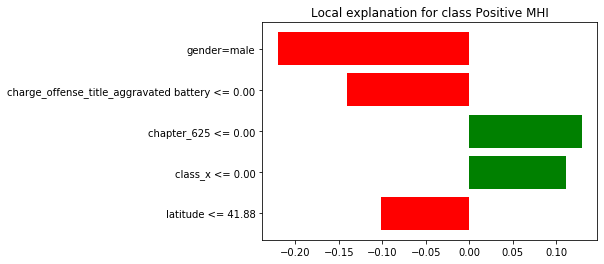

In [36]:
# Generate individual explanation
i = 80
print('Actual class: ', labels_test[i])
exp = explainer.explain_instance((X_test_decoded.values[i]), predict_fn, num_features=5)

# Visualize the explanation 
%matplotlib inline
fig = exp.as_pyplot_figure()

exp.show_in_notebook(show_all=False)

In [37]:
# Initialize the SP object
sp_obj = submodular_pick.SubmodularPick(explainer, X_train_decoded.values, predict_fn, sample_size=10, 
                                        num_features=5, num_exps_desired=8)

In [38]:
sp_obj.V

[1, 7, 4, 8, 9, 6, 5, 3]

#### Why are these indices all so low?

Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


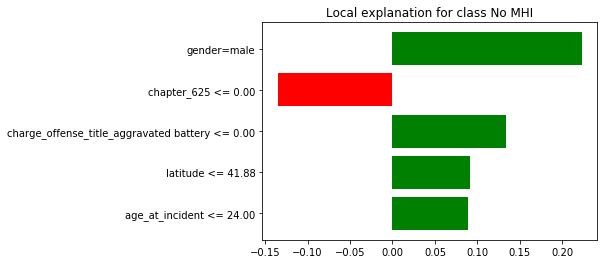

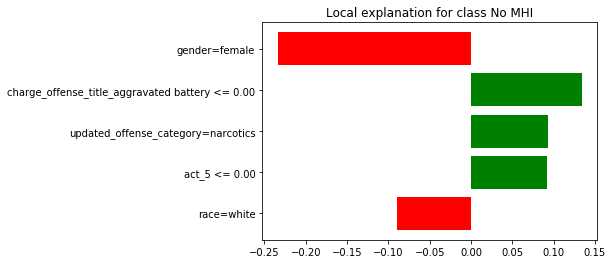

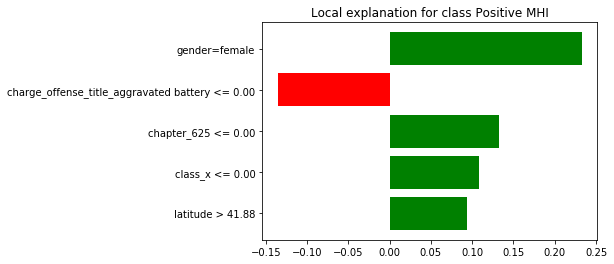

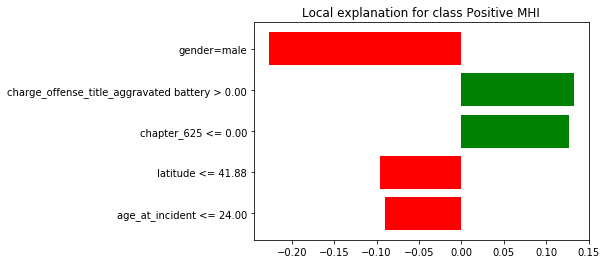

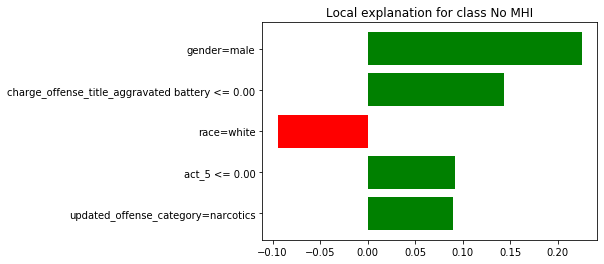

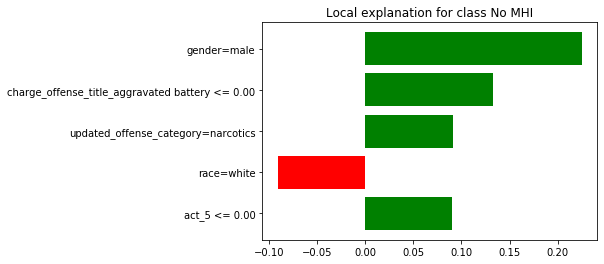

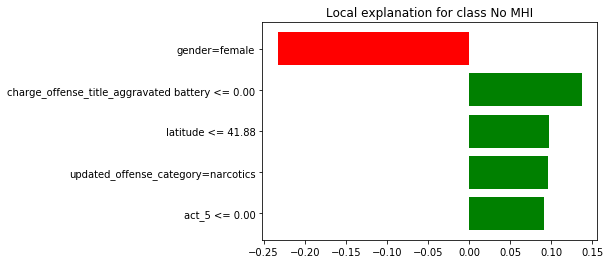

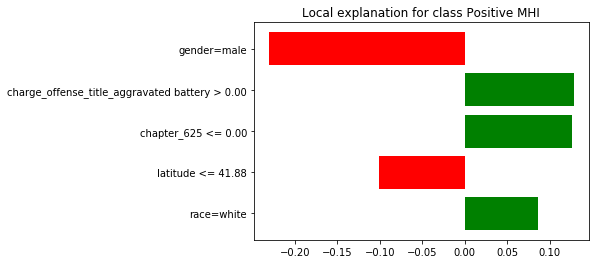

In [39]:
j = 0
for ind in sp_obj.V:
    exp = explainer.explain_instance(X_train_decoded.values[ind], predict_fn, num_features=5)
    print("Actual class: ", labels_test[ind])
    exp.show_in_notebook(show_all=False)
    exp.save_to_file('LIME_'+str(j))
    label = sp_obj.sp_explanations[j].available_labels()[0]
    sp_obj.sp_explanations[j].as_pyplot_figure(label=label)
    print("==========================")
    j+=1

# Section 4: Investigations into possible race proxies

In [4]:
from scipy.stats import ks_2samp
from scipy.stats import entropy

def ks_test(df_in: pd.DataFrame, df_out: pd.DataFrame, attr: str):
    """
    df_in: the sensitive dataset
    df_out: the synthetic dataset
    attr: the attribute that will be calculated for Two-sample Kolmogorov–Smirnov test.
    """
    return ks_2samp(df_in[attr], df_out[attr])[0]

def get_distribution_of_categorical_attribute(attribute: pd.Series, indicies=None):
    distribution = attribute.dropna().value_counts()
    if indicies is not None:
        for idx in set(indicies) - set(distribution.index):
            distribution.loc[idx] = 0
    distribution.sort_index(inplace=True)
    return distribution/sum(distribution)

def kl_test(df_in: pd.DataFrame, df_out: pd.DataFrame, attr: str):
    """
    df_in: the sensitive dataset
    df_out: the synthetic dataset
    attr: the attribute that will be calculated for KL-divergence.
    """
    distribution_in = get_distribution_of_categorical_attribute(df_in[attr])
    distribution_out = get_distribution_of_categorical_attribute(df_out[attr], distribution_in.index)
    return entropy(distribution_out, distribution_in)

In [5]:
cols = list(total_df.columns)
gender_cols = [i for i in cols if i.startswith('gender')]
race_cols = [i for i in cols if i.startswith('race')]
print(gender_cols)
print(race_cols)

['gender_female', 'gender_male', 'gender_unknown']
['race_albino', 'race_american indian', 'race_asian', 'race_biracial', 'race_black', 'race_hispanic', 'race_unknown', 'race_white', 'race_white [hispanic or latino]', 'race_white/black [hispanic or latino]']


In [6]:
def check_allcols_are_binary(df, start_string):
    ''' 
    Takes a OHE df and a string and checks if all columns starting with 
    that string are binary. If all columns are binary it returns the list of
    all column names, otherwise it returns a list of non_binary_cols.
    
    df: dataframe containing the OHE columns and data
    start_string: string that the OHE columns starts with (i.e. 'gender') 
    would return OHE columns ['gender_female', 'gender_male', 'gender_unknown']
    '''
    
    col_selection = [i for i in list(df.columns) if i.startswith(start_string)]
    non_binary_cols = []
    for column in col_selection:
        if is_binary(df[column]) != True:
            non_binary_cols.append(column)
    if non_binary_cols == []:
        print('All columns binary, returning complete column list')
        return col_selection
    else:
        print('Some columns not binary, returning list of non-binary columns')
        return non_binary_cols

In [7]:
# inpsiration from: https://stackoverflow.com/questions/38334296/reversing-
# one-hot-encoding-in-pandas
def undo_ohe_cols(df, col_subset):
    ''' 
    Takes a OHE df and a list of BINARY columns and undoes the OHE of those
    columns, returning a single series with original values in it.
    
    df: dataframe containing the OHE columns and data 
    col_subset: list of binary OHE columns on which you want to undo OHE
    '''

    df_subset = df[df.columns & col_subset]
    def undo_binary(row):
        for c in df_subset.columns:
            if row[c]==1:
                return c
    single_col = df_subset.apply(undo_binary, axis=1)
    return single_col

In [8]:
# check all cols are binary
race_cols = check_allcols_are_binary(total_df, 'race')

# since all binday, can undo-OHE
single_race_col = undo_ohe_cols(total_df, race_cols)

single_race_col.head()

All columns binary, returning complete column list


case_participant_id
260122253823                         race_black
272161011760                         race_black
864286527653                      race_hispanic
882206007016                         race_black
882242005211    race_white [hispanic or latino]
dtype: object

In [9]:
# check all cols are binary
gender_cols = check_allcols_are_binary(total_df, 'gender')

# since all binday, can undo-OHE
single_gender_col = undo_ohe_cols(total_df, gender_cols)

All columns binary, returning complete column list


### Looking at the distribution of charge_count in the whole population vs in sub-populations (by race). Here charge_count is already a numeric feature, so we don't have to undo one hot encoding. Seems like there could be some higher charge_counts for american indian and biracial, but these are small sample sizes.

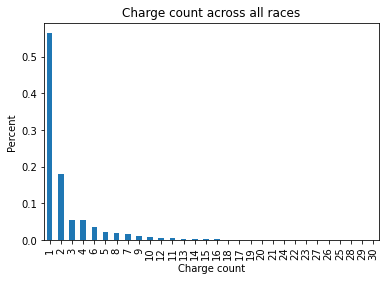

In [10]:
# charge count, all races
len(total_df['charge_count'].unique())
val_counts = total_df['charge_count'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('Charge count')
plt.title('Charge count across all races')

top20allraces = list(total_df['charge_count'].value_counts().nlargest(20).index)

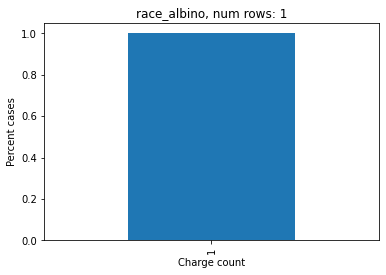

ks_test:  0.4353705023279625
items in top 10 for this race that are not in top 20 items for all races:  set()


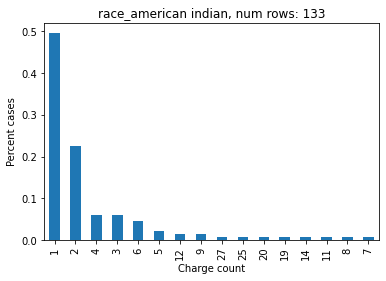

ks_test:  0.06838889616827815
items in top 10 for this race that are not in top 20 items for all races:  {25, 27}


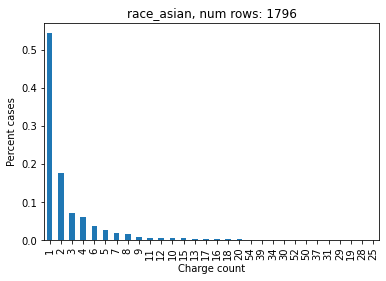

ks_test:  0.025920746518387272
items in top 10 for this race that are not in top 20 items for all races:  set()


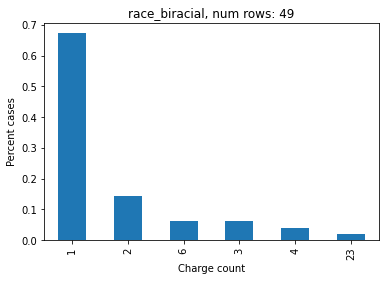

ks_test:  0.1088398900830645
items in top 10 for this race that are not in top 20 items for all races:  {23}


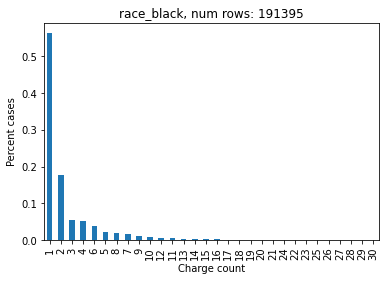

ks_test:  0.006214021903543809
items in top 10 for this race that are not in top 20 items for all races:  set()


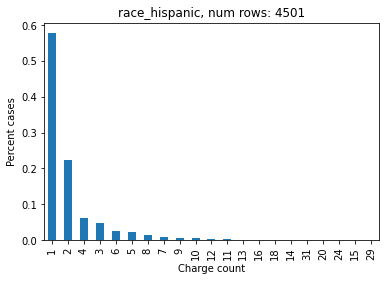

ks_test:  0.056505318647922076
items in top 10 for this race that are not in top 20 items for all races:  set()


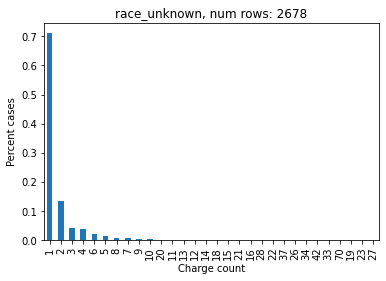

ks_test:  0.1470956703638101
items in top 10 for this race that are not in top 20 items for all races:  set()


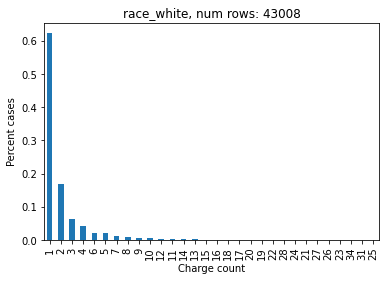

ks_test:  0.058766149649391086
items in top 10 for this race that are not in top 20 items for all races:  set()


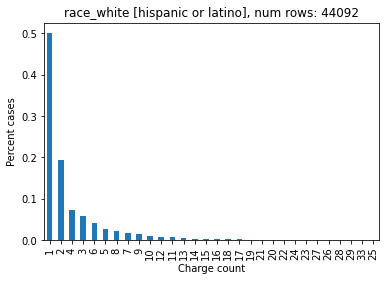

ks_test:  0.06399446183787261
items in top 10 for this race that are not in top 20 items for all races:  set()


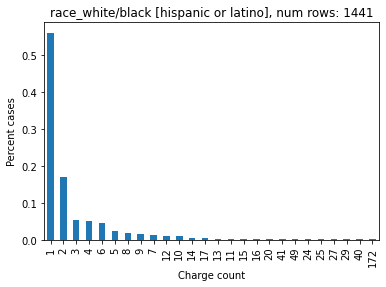

ks_test:  0.017384638169911093
items in top 10 for this race that are not in top 20 items for all races:  set()


In [11]:
# looking at charge count distributions for each race 
for col in race_cols:
    race_df = total_df[total_df[col] == 1]
    val_counts = race_df['charge_count'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Charge count')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('ks_test: ', ks_test(total_df, race_df, 'charge_count'))
    
    # print chg counts in top 10 that are not in top 20 across all races
    top10 = race_df['charge_count'].value_counts(normalize=True).nlargest(10).index
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

### Repeating same process but looking at offense_category distributions. Note, this (and all following colums were OHE so we have to undo the OHE first). We don't see any real differences across total population and sub populations except for american indian and biracial, which each have relatively small sample size. 

In [12]:
# looking at offense_category
off_cols = check_allcols_are_binary(total_df, 'offense')

# all binary, so undoing OHE
single_off_col = undo_ohe_cols(total_df, off_cols)

All columns binary, returning complete column list


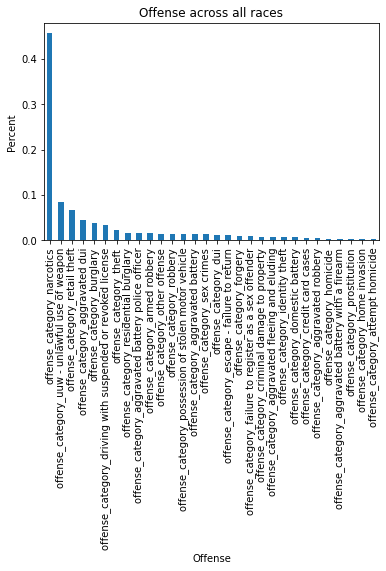

In [13]:
# looking at offense_category distribution for all races

# combining two series 
off_race_df = pd.concat([single_off_col.rename('offense'), single_race_col.rename('race')],
                        axis = 1)
val_counts = off_race_df['offense'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('Offense')
plt.title('Offense across all races')

# saving top 20 offense_category across all races
top20allraces = list(off_race_df['offense'].value_counts().nlargest(20).index)

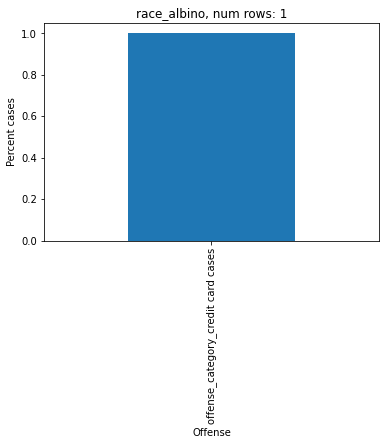

kl_test:  5.30349863544374
items in top 10 for this race that are not in top 20 items for all races:  {'offense_category_credit card cases'}


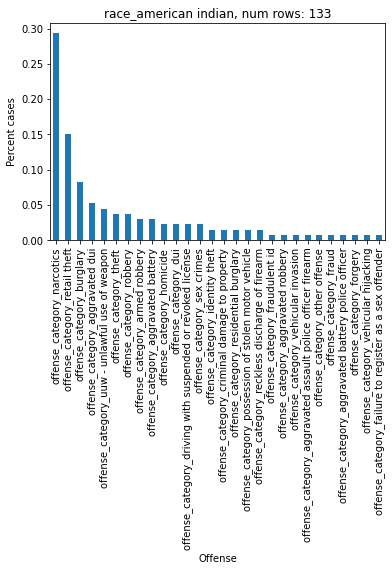

kl_test:  0.2993207886380759
items in top 10 for this race that are not in top 20 items for all races:  {'offense_category_homicide'}


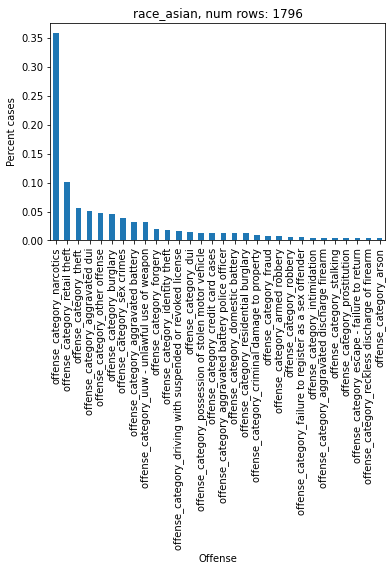

kl_test:  0.18615271057985555
items in top 10 for this race that are not in top 20 items for all races:  set()


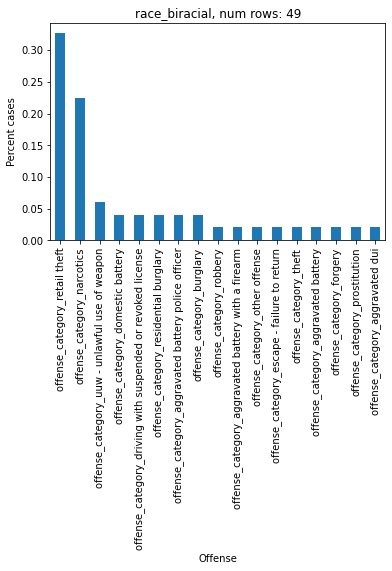

kl_test:  0.5960652819589437
items in top 10 for this race that are not in top 20 items for all races:  {'offense_category_domestic battery', 'offense_category_prostitution'}


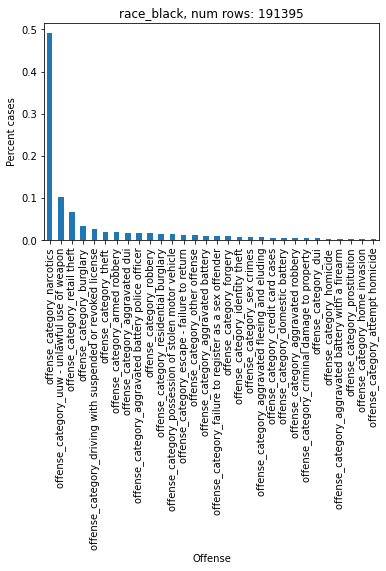

kl_test:  0.02132405743744574
items in top 10 for this race that are not in top 20 items for all races:  set()


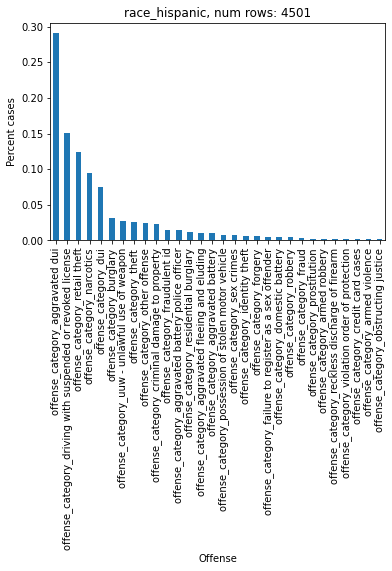

kl_test:  0.832861762774557
items in top 10 for this race that are not in top 20 items for all races:  set()


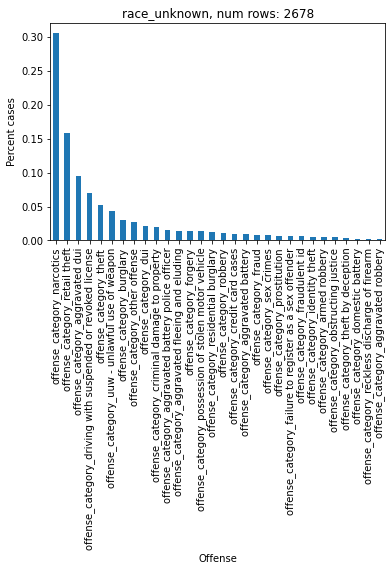

kl_test:  0.21036879846971263
items in top 10 for this race that are not in top 20 items for all races:  set()


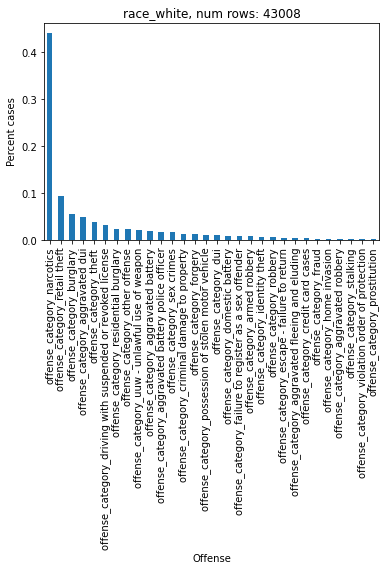

kl_test:  0.0725278748109411
items in top 10 for this race that are not in top 20 items for all races:  set()


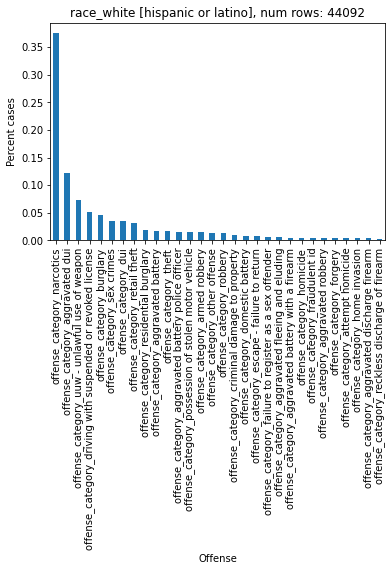

kl_test:  0.11231900155601396
items in top 10 for this race that are not in top 20 items for all races:  set()


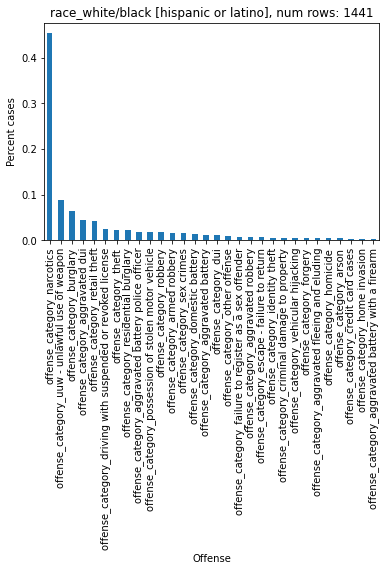

kl_test:  0.04913036050275245
items in top 10 for this race that are not in top 20 items for all races:  set()


In [14]:
# looking at offense distributions for each race
all_race_df = off_race_df

for col in race_cols:
    race_df = off_race_df[off_race_df['race'] == col]
    val_counts = race_df['offense'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Offense')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'offense'))
    top10 = race_df['offense'].value_counts(normalize=True).nlargest(10).index
    
    # print categories in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

### Repeating same process but looking at unit distribution. Nothing super noticeable here.

In [15]:
# check all cols are binary
unit_cols = check_allcols_are_binary(total_df, 'unit')

# all binary so undoing OHE
single_unit_col = undo_ohe_cols(total_df, unit_cols)

All columns binary, returning complete column list


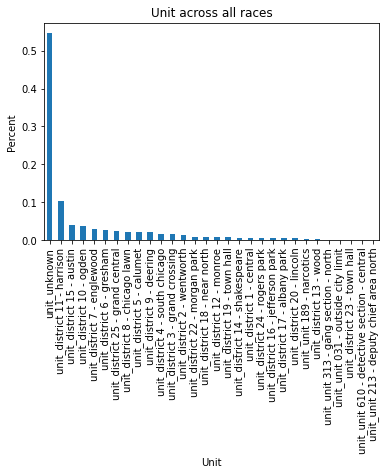

In [16]:
# looking at unit distribution for all races

# combining two series 
unit_race_df = pd.concat([single_unit_col.rename('unit'), 
                         single_race_col.rename('race')], axis = 1)
val_counts = unit_race_df['unit'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('Unit')
plt.title('Unit across all races')

# saving top 20 unit across all races
top20allraces = list(unit_race_df['unit'].value_counts().nlargest(20).index)

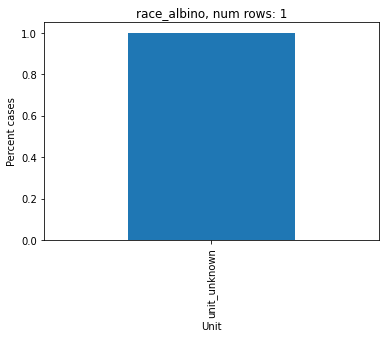

kl_test:  0.6033913320234576
items in top 10 for this race that are not in top 20 items for all races:  set()


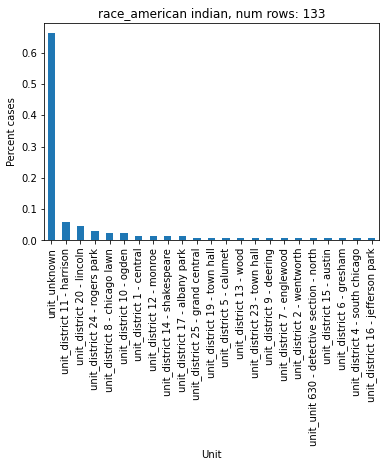

kl_test:  0.2677751886363217
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 20 - lincoln', 'unit_district 17 - albany park'}


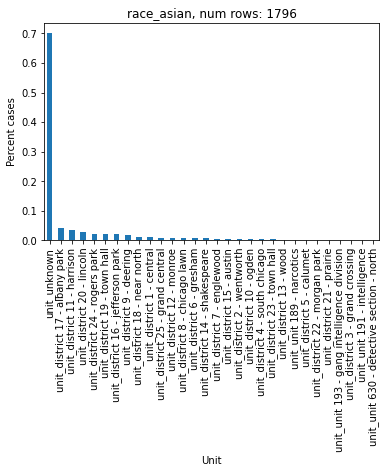

kl_test:  0.3083899703135631
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 20 - lincoln', 'unit_district 17 - albany park', 'unit_district 16 - jefferson park'}


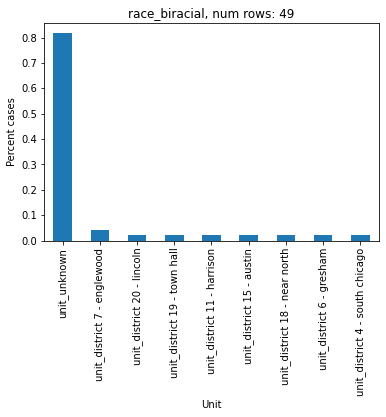

kl_test:  0.361930694638898
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 20 - lincoln'}


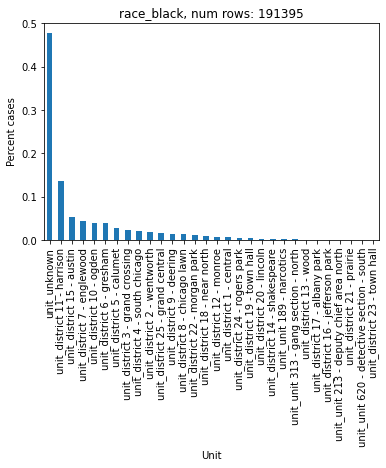

kl_test:  0.03193284360288405
items in top 10 for this race that are not in top 20 items for all races:  set()


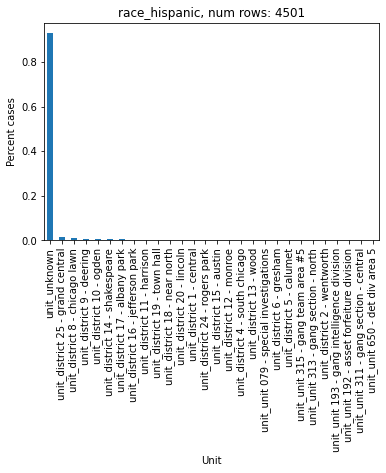

kl_test:  0.4180014399713881
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 17 - albany park', 'unit_district 16 - jefferson park'}


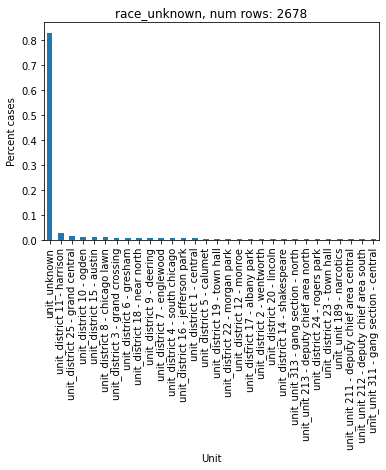

kl_test:  0.2087565555641273
items in top 10 for this race that are not in top 20 items for all races:  set()


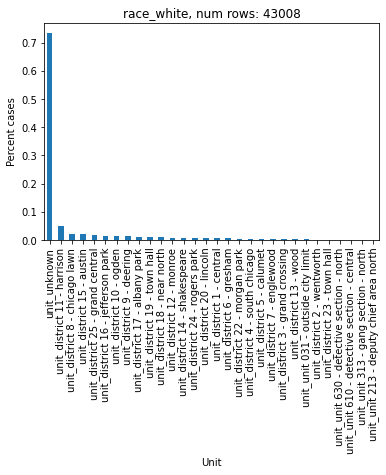

kl_test:  0.14211851224246552
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 17 - albany park', 'unit_district 16 - jefferson park'}


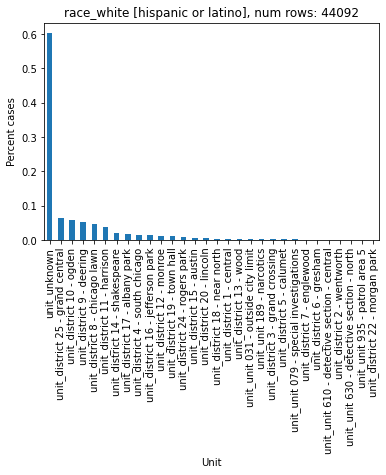

kl_test:  0.22284377853675608
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 17 - albany park', 'unit_district 16 - jefferson park'}


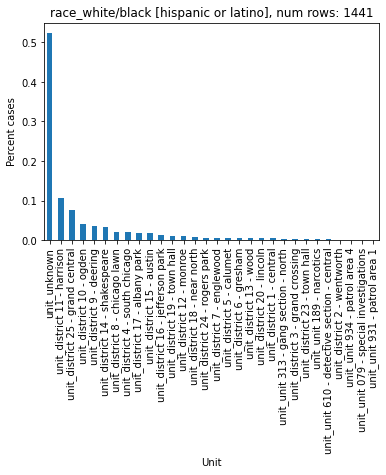

kl_test:  0.16811407795769814
items in top 10 for this race that are not in top 20 items for all races:  {'unit_district 17 - albany park'}


In [17]:
# looking at unit distributions for each race
all_race_df = unit_race_df

for col in race_cols:
    race_df = unit_race_df[unit_race_df['race'] == col]
    val_counts = race_df['unit'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Unit')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'unit'))
    top10 = race_df['unit'].value_counts(normalize=True).nlargest(10).index
    
    # print units in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

### Repeating same process but looking at law_enforcement_agency distribution. See some pretty clear racial divides in neighborhoods and law_enforcement_agencys in the subpopulation graphs

In [18]:
# could be repeated for law_enforcement_agency

# check all cols are binary
law_cols = check_allcols_are_binary(total_df, 'law')

# all binary so undoing OHE
single_law_col = undo_ohe_cols(total_df, law_cols)

All columns binary, returning complete column list


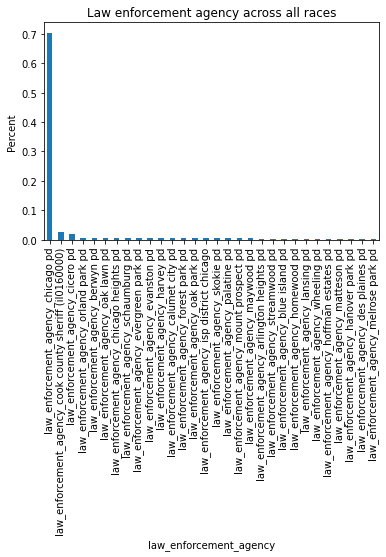

In [19]:
# looking at law_enforcement_agency distribution for all races

# combining two series 
law_race_df = pd.concat([single_law_col.rename('law_enforcement_agency'), 
                         single_race_col.rename('race')], axis = 1)
val_counts = law_race_df['law_enforcement_agency'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('law_enforcement_agency')
plt.title('Law enforcement agency across all races')

# saving top 20 law_enfrocement_agency across all races
top20allraces = list(law_race_df['law_enforcement_agency'].value_counts().nlargest(20).index)

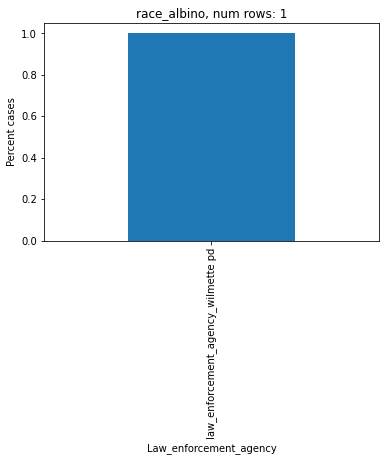

kl_test:  6.575570611778049
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_wilmette pd'}


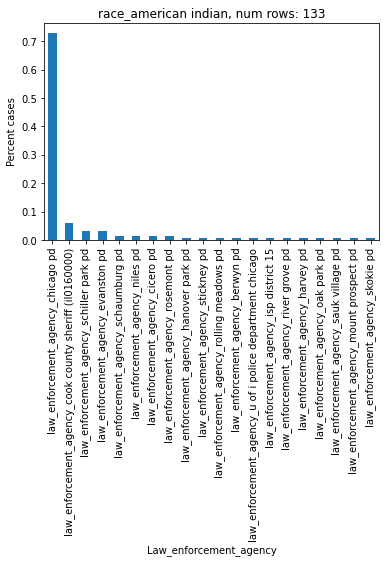

kl_test:  0.3822467243664565
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_sauk village pd', 'law_enforcement_agency_schiller park pd', 'law_enforcement_agency_niles pd', 'law_enforcement_agency_rosemont pd'}


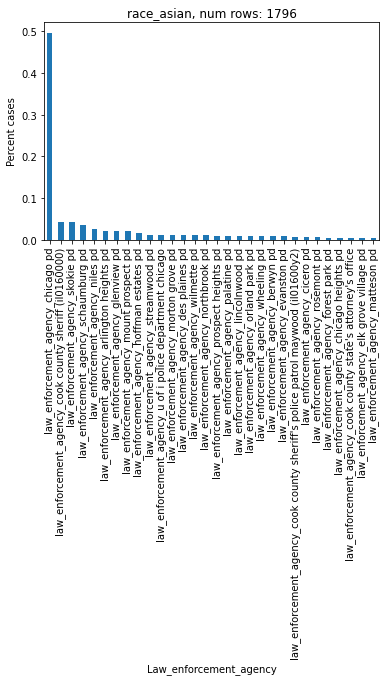

kl_test:  0.44832879038170353
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_streamwood pd', 'law_enforcement_agency_hoffman estates pd', 'law_enforcement_agency_glenview pd', 'law_enforcement_agency_niles pd'}


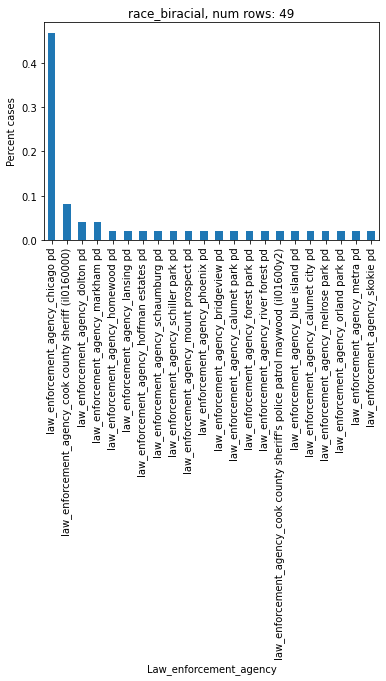

kl_test:  0.8983346995809111
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_blue island pd', 'law_enforcement_agency_melrose park pd', "law_enforcement_agency_cook county sheriff's police patrol maywood (il01600y2)", 'law_enforcement_agency_metra pd', 'law_enforcement_agency_dolton pd', 'law_enforcement_agency_markham pd'}


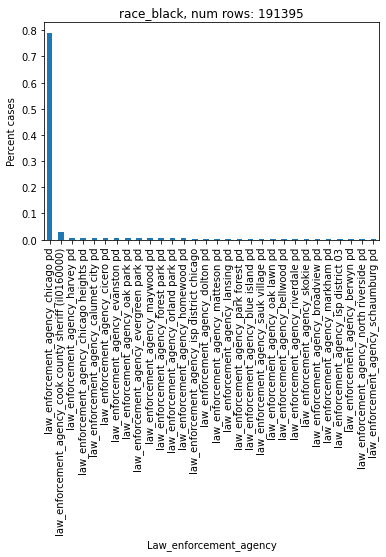

kl_test:  0.05082778813110558
items in top 10 for this race that are not in top 20 items for all races:  set()


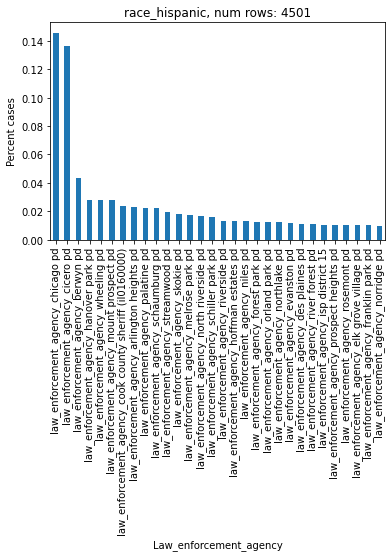

kl_test:  1.0362988366104031
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_wheeling pd', 'law_enforcement_agency_hanover park pd'}


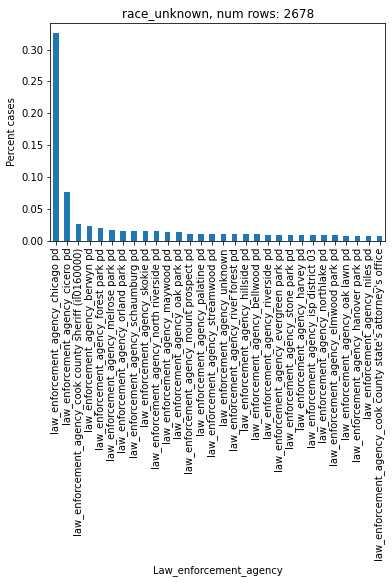

kl_test:  0.45563699768589183
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_melrose park pd', 'law_enforcement_agency_north riverside pd'}


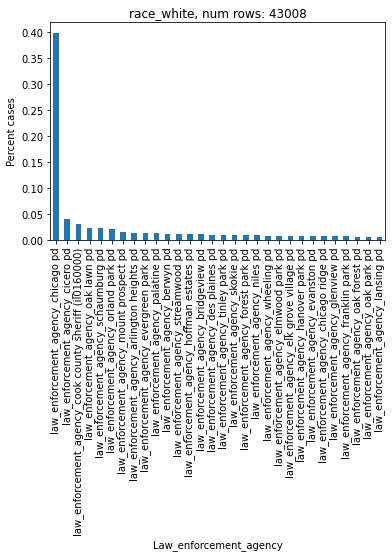

kl_test:  0.2953812487934171
items in top 10 for this race that are not in top 20 items for all races:  set()


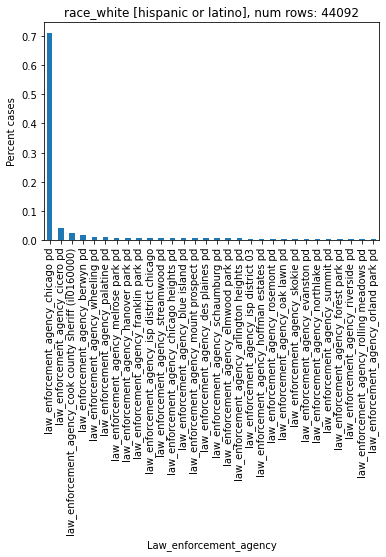

kl_test:  0.06499914946986557
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_franklin park pd', 'law_enforcement_agency_melrose park pd', 'law_enforcement_agency_wheeling pd', 'law_enforcement_agency_hanover park pd'}


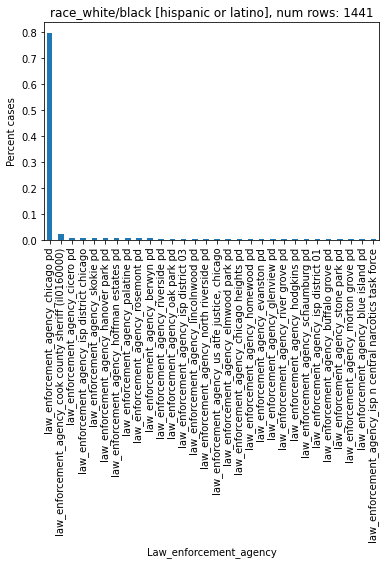

kl_test:  0.13433363063950005
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_hoffman estates pd', 'law_enforcement_agency_rosemont pd', 'law_enforcement_agency_hanover park pd'}


In [20]:
# looking at law_enforcement_agency distributions for each race
all_race_df = law_race_df

for col in race_cols:
    race_df = law_race_df[law_race_df['race'] == col]
    val_counts = race_df['law_enforcement_agency'].value_counts(normalize=
                                                               True).nlargest(30).plot(kind=
                                                                                       'bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Law_enforcement_agency')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'law_enforcement_agency'))
    top10 = race_df['law_enforcement_agency'].value_counts(normalize=True).nlargest(10).index
    
    # print agencies in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

### Diving a little deeper to see correlations between certain neighborhoods and races. For example, we see 'law_enforcement_agency_wheeling pd' and 'law_enforcement_agency_hanover park pd' in 'race_hispanic' and 'race_white [hispanic or latino]'   distribution top 10, but not top 20 of all races.. Does it have a high correlation with hispanic? 

In [21]:
# one hot encoding law_enforcement_agency and race
dummy_lawrace = pd.get_dummies(law_race_df)
dummy_lawrace.head()

,law_enforcement_agency_law_enforcement_agency_alsip pd,law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp,law_enforcement_agency_law_enforcement_agency_arlington heights pd,law_enforcement_agency_law_enforcement_agency_barrington hills pd,law_enforcement_agency_law_enforcement_agency_barrington pd,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_bellwood pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_bolingbrook p.d.,law_enforcement_agency_law_enforcement_agency_bridgeview pd,law_enforcement_agency_law_enforcement_agency_broadview pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_burlington northern santa fe railroad pd,law_enforcement_agency_law_enforcement_agency_burnham pd,law_enforcement_agency_law_enforcement_agency_burr ridge pd,law_enforcement_agency_law_enforcement_agency_c p d area 1 dist 2,law_enforcement_agency_law_enforcement_agency_c p d area 2,law_enforcement_agency_law_enforcement_agency_c p d area 3,law_enforcement_agency_law_enforcement_agency_c p d area 4 vc,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_calumet city police department,law_enforcement_agency_law_enforcement_agency_calumet park pd,law_enforcement_agency_law_enforcement_agency_canadian national railroad police,law_enforcement_agency_law_enforcement_agency_carol stream pd,law_enforcement_agency_law_enforcement_agency_chicago heights pd,law_enforcement_agency_law_enforcement_agency_chicago pd,law_enforcement_agency_law_enforcement_agency_chicago pd - area central,law_enforcement_agency_law_enforcement_agency_chicago pd - area south,law_enforcement_agency_law_enforcement_agency_chicago police dept,law_enforcement_agency_law_enforcement_agency_chicago ridge pd,law_enforcement_agency_law_enforcement_agency_chicago state univ pd,"law_enforcement_agency_law_enforcement_agency_chicago transit auth, insp general",law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_conrail railroad pd,law_enforcement_agency_law_enforcement_agency_cook co sheriff off,law_enforcement_agency_law_enforcement_agency_cook county dept. of corrections,law_enforcement_agency_law_enforcement_agency_cook county forest preserve police dept,law_enforcement_agency_law_enforcement_agency_cook county john stroger hsptl police department,law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - markham (il01600y6),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - maywood (il01600x9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's fugitive-warrants (il0169q00),law_enforcement_agency_law_enforcement_agency_cook county sheriff's gangs (il01600e8),law_enforcement_agency_law_enforcement_agency_cook county sheriff's patrol desk (il01600e9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol - dom viol (il016b300),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol bridgeview (il016a700),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol crim ct (il016b200),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol desplaines (il016a900),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol markham (

In [22]:
# making abs value corr matrix so we can sort by "largest" regardless of correlation direction
corr = dummy_lawrace.corr()
corrabs = corr.abs()

In [23]:
corrabs['law_enforcement_agency_law_enforcement_agency_hanover park pd'].nlargest(7)

law_enforcement_agency_law_enforcement_agency_hanover park pd                    1.000000
law_enforcement_agency_law_enforcement_agency_chicago pd                         0.085999
race_race_hispanic                                                               0.056441
race_race_black                                                                  0.056430
race_race_white                                                                  0.027177
race_race_white [hispanic or latino]                                             0.024586
law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000)    0.009293
Name: law_enforcement_agency_law_enforcement_agency_hanover park pd, dtype: float64

In [24]:
corrabs['law_enforcement_agency_law_enforcement_agency_wheeling pd'].nlargest(7)

law_enforcement_agency_law_enforcement_agency_wheeling pd                        1.000000
law_enforcement_agency_law_enforcement_agency_chicago pd                         0.090012
race_race_black                                                                  0.071723
race_race_hispanic                                                               0.052822
race_race_white [hispanic or latino]                                             0.042226
race_race_white                                                                  0.031891
law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000)    0.009727
Name: law_enforcement_agency_law_enforcement_agency_wheeling pd, dtype: float64

# Section 6: Looking into relationship between incident_city and law_enforcement_agency

In [25]:
# checking incident_city binary

# check all cols are binary
city_cols = check_allcols_are_binary(total_df, 'incident_city')

# all binary so undoing OHE
single_city_col = undo_ohe_cols(total_df, city_cols)

All columns binary, returning complete column list


In [26]:
# making combined df of law_enforcement_agency and incident_city
city_law_df = pd.concat([single_law_col.rename('law_enforcement_agency'), 
                         single_city_col.rename('incident_city')], axis = 1)

In [27]:
# ohe both columns
dummy_law_city = pd.get_dummies(city_law_df)
dummy_law_city.head()

,law_enforcement_agency_law_enforcement_agency_alsip pd,law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp,law_enforcement_agency_law_enforcement_agency_arlington heights pd,law_enforcement_agency_law_enforcement_agency_barrington hills pd,law_enforcement_agency_law_enforcement_agency_barrington pd,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_bellwood pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_bolingbrook p.d.,law_enforcement_agency_law_enforcement_agency_bridgeview pd,law_enforcement_agency_law_enforcement_agency_broadview pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_burlington northern santa fe railroad pd,law_enforcement_agency_law_enforcement_agency_burnham pd,law_enforcement_agency_law_enforcement_agency_burr ridge pd,law_enforcement_agency_law_enforcement_agency_c p d area 1 dist 2,law_enforcement_agency_law_enforcement_agency_c p d area 2,law_enforcement_agency_law_enforcement_agency_c p d area 3,law_enforcement_agency_law_enforcement_agency_c p d area 4 vc,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_calumet city police department,law_enforcement_agency_law_enforcement_agency_calumet park pd,law_enforcement_agency_law_enforcement_agency_canadian national railroad police,law_enforcement_agency_law_enforcement_agency_carol stream pd,law_enforcement_agency_law_enforcement_agency_chicago heights pd,law_enforcement_agency_law_enforcement_agency_chicago pd,law_enforcement_agency_law_enforcement_agency_chicago pd - area central,law_enforcement_agency_law_enforcement_agency_chicago pd - area south,law_enforcement_agency_law_enforcement_agency_chicago police dept,law_enforcement_agency_law_enforcement_agency_chicago ridge pd,law_enforcement_agency_law_enforcement_agency_chicago state univ pd,"law_enforcement_agency_law_enforcement_agency_chicago transit auth, insp general",law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_conrail railroad pd,law_enforcement_agency_law_enforcement_agency_cook co sheriff off,law_enforcement_agency_law_enforcement_agency_cook county dept. of corrections,law_enforcement_agency_law_enforcement_agency_cook county forest preserve police dept,law_enforcement_agency_law_enforcement_agency_cook county john stroger hsptl police department,law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - markham (il01600y6),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - maywood (il01600x9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's fugitive-warrants (il0169q00),law_enforcement_agency_law_enforcement_agency_cook county sheriff's gangs (il01600e8),law_enforcement_agency_law_enforcement_agency_cook county sheriff's patrol desk (il01600e9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol - dom viol (il016b300),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol bridgeview (il016a700),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol crim ct (il016b200),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol desplaines (il016a900),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol markham (

[Text(0.5, 0, 'law_enforcement_agency_law_enforcement_agency_alsip pd'),
 Text(22.5, 0, 'law_enforcement_agency_law_enforcement_agency_c p d area 3'),
 Text(44.5, 0, "law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9)"),
 Text(66.5, 0, 'law_enforcement_agency_law_enforcement_agency_crestwood pd'),
 Text(88.5, 0, 'law_enforcement_agency_law_enforcement_agency_franklin park pd'),
 Text(110.5, 0, 'law_enforcement_agency_law_enforcement_agency_idoc pontiac'),
 Text(132.5, 0, 'law_enforcement_agency_law_enforcement_agency_isp district 04'),
 Text(154.5, 0, 'law_enforcement_agency_law_enforcement_agency_isp doo zone 1, elgin'),
 Text(176.5, 0, 'law_enforcement_agency_law_enforcement_agency_lynwood pd'),
 Text(198.5, 0, 'law_enforcement_agency_law_enforcement_agency_norridge pd'),
 Text(220.5, 0, 'law_enforcement_agency_law_enforcement_agency_phoenix pd'),
 Text(242.5, 0, 'law_enforcement_agency_law_enforcement_agency_south suburban college 

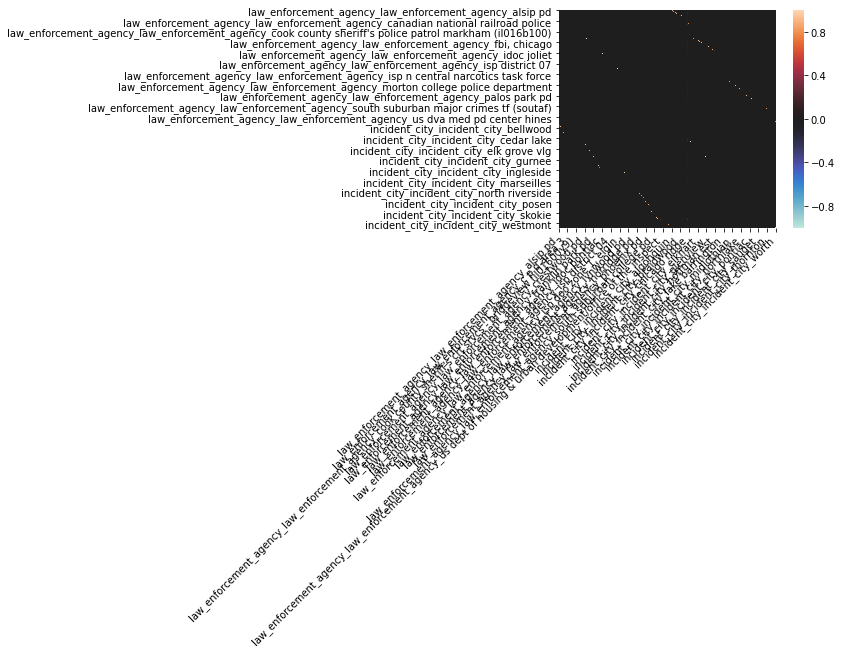

In [28]:
# trying big heat map

corr = dummy_law_city.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    #cmap=sns.diverging_palette(20, 220, n=200),
    square=True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right')

In [29]:
# heatmap pretty illegible so looking just at row/cols with values above 0.9-> reduces to dimension ~100
m = (corr.mask(np.eye(len(corr), dtype=bool)).abs() > 0.9).any()
raw = corr.loc[m, m]
raw

,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_countryside pd,law_enforcement_agency_law_enforcement_agency_crestwood pd,law_enforcement_agency_law_enforcement_agency_deerfield pd,law_enforcement_agency_law_enforcement_agency_elgin pd,law_enforcement_agency_law_enforcement_agency_elmwood park pd,law_enforcement_agency_law_enforcement_agency_evanston pd,law_enforcement_agency_law_enforcement_agency_evergreen park pd,law_enforcement_agency_law_enforcement_agency_flossmoor pd,law_enforcement_agency_law_enforcement_agency_forest park pd,law_enforcement_agency_law_enforcement_agency_glenwood pd,law_enforcement_agency_law_enforcement_agency_hanover park pd,law_enforcement_agency_law_enforcement_agency_harwood heights pd,law_enforcement_agency_law_enforcement_agency_hodgkins pd,law_enforcement_agency_law_enforcement_agency_homewood pd,law_enforcement_agency_law_enforcement_agency_inverness police department,law_enforcement_agency_law_enforcement_agency_kenilworth pd,law_enforcement_agency_law_enforcement_agency_lansing pd,law_enforcement_agency_law_enforcement_agency_lemont pd,law_enforcement_agency_law_enforcement_agency_lincolnwood pd,law_enforcement_agency_law_enforcement_agency_matteson pd,law_enforcement_agency_law_enforcement_agency_midlothian pd,law_enforcement_agency_law_enforcement_agency_morton grove pd,law_enforcement_agency_law_enforcement_agency_niles pd,law_enforcement_agency_law_enforcement_agency_norridge pd,law_enforcement_agency_law_enforcement_agency_north riverside pd,law_enforcement_agency_law_enforcement_agency_northlake pd,law_enforcement_agency_law_enforcement_agency_oak lawn pd,law_enforcement_agency_law_enforcement_agency_palatine pd,law_enforcement_agency_law_enforcement_agency_park forest pd,law_enforcement_agency_law_enforcement_agency_park ridge pd,law_enforcement_agency_law_enforcement_agency_phoenix pd,law_enforcement_agency_law_enforcement_agency_prospect heights pd,law_enforcement_agency_law_enforcement_agency_richton park pd,law_enforcement_agency_law_enforcement_agency_river forest pd,law_enforcement_agency_law_enforcement_agency_rosemont pd,law_enforcement_agency_law_enforcement_agency_sauk village pd,law_enforcement_agency_law_enforcement_agency_schaumburg pd,law_enforcement_agency_law_enforcement_agency_schiller park pd,law_enforcement_agency_law_enforcement_agency_streamwood pd,law_enforcement_agency_law_enforcement_agency_summit pd,law_enforcement_agency_law_enforcement_agency_tinley park pd,law_enforcement_agency_law_enforcement_agency_westchester pd,law_enforcement_agency_law_enforcement_agency_wheeling pd,incident_city_incident_city_bartlett,incident_city_incident_city_bedford park,incident_city_incident_city_berkeley,incident_city_incident_city_berwyn,incident_city_incident_city_blue island,incident_city_incident_city_brookfield,incident_city_incident_city_buffalo grove,incident_city_incident_city_burbank,incident_city_incident_city_calumet city,incident_city_incident_city_cicero,incident_city_incident_city_countryside,incident_city_incident_city_crestwood,incident_city_incident_city_deerfield,incident_city_incident_city_elgin,incident_city_incident_city_elmwood park,incident_city_incident_city_evanston,incident_city_incident_city_evergreen park,incident_city_incident_city_flossmoor,incident_city_incident_city_forest park,incident_city_incident_city_glenwood,incident_city_incident_city_hanover park,incident_

[Text(0.5, 0, 'law_enforcement_agency_law_enforcement_agency_bartlett pd'),
 Text(5.5, 0, 'law_enforcement_agency_law_enforcement_agency_brookfield pd'),
 Text(10.5, 0, 'law_enforcement_agency_law_enforcement_agency_countryside pd'),
 Text(15.5, 0, 'law_enforcement_agency_law_enforcement_agency_evanston pd'),
 Text(20.5, 0, 'law_enforcement_agency_law_enforcement_agency_hanover park pd'),
 Text(25.5, 0, 'law_enforcement_agency_law_enforcement_agency_kenilworth pd'),
 Text(30.5, 0, 'law_enforcement_agency_law_enforcement_agency_midlothian pd'),
 Text(35.5, 0, 'law_enforcement_agency_law_enforcement_agency_northlake pd'),
 Text(40.5, 0, 'law_enforcement_agency_law_enforcement_agency_phoenix pd'),
 Text(45.5, 0, 'law_enforcement_agency_law_enforcement_agency_sauk village pd'),
 Text(50.5, 0, 'law_enforcement_agency_law_enforcement_agency_tinley park pd'),
 Text(55.5, 0, 'incident_city_incident_city_berkeley'),
 Text(60.5, 0, 'incident_city_incident_city_burbank'),
 Text(65.5, 0, 'incident

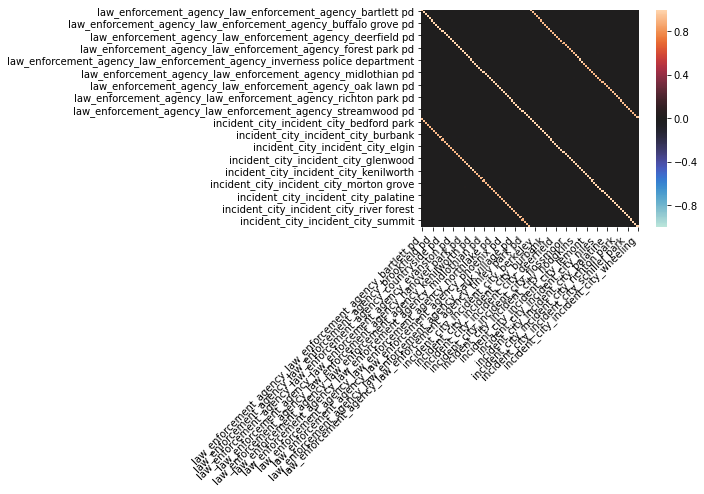

In [30]:
# trying heat map again with just 100 top correlated features 

ax = sns.heatmap(
    raw, 
    vmin=-1, vmax=1, center=0,
    #cmap=sns.diverging_palette(20, 220, n=200),
    square=True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right')

### Above we can see some of the correlations (where they exist) between incident_city and law_enforcement_agency. Below some of the explict correlation values.

In [31]:
raw['incident_city_incident_city_bedford park'].nlargest(5)

incident_city_incident_city_bedford park                                     1.000000
law_enforcement_agency_law_enforcement_agency_bedford park pd                0.938504
law_enforcement_agency_law_enforcement_agency_summit pd                      0.001483
law_enforcement_agency_law_enforcement_agency_burbank pd                     0.000968
law_enforcement_agency_law_enforcement_agency_inverness police department   -0.000189
Name: incident_city_incident_city_bedford park, dtype: float64

In [32]:
raw['law_enforcement_agency_law_enforcement_agency_bartlett pd'].nlargest(5)

law_enforcement_agency_law_enforcement_agency_bartlett pd                    1.000000
incident_city_incident_city_bartlett                                         0.949413
incident_city_incident_city_hanover park                                     0.000633
incident_city_incident_city_streamwood                                       0.000270
law_enforcement_agency_law_enforcement_agency_inverness police department   -0.000156
Name: law_enforcement_agency_law_enforcement_agency_bartlett pd, dtype: float64

In [33]:
raw['law_enforcement_agency_law_enforcement_agency_streamwood pd'].nlargest(5)

law_enforcement_agency_law_enforcement_agency_streamwood pd    1.000000
incident_city_incident_city_streamwood                         0.946547
incident_city_incident_city_hanover park                       0.012641
incident_city_incident_city_schaumburg                         0.005578
incident_city_incident_city_bartlett                           0.002280
Name: law_enforcement_agency_law_enforcement_agency_streamwood pd, dtype: float64

In [34]:
# Looking at each row in complete OHE dataset to see if each one has a match
corrabs = corr.abs()
for col in corrabs.columns[:40]:
    print(corrabs[col].nlargest(2))

law_enforcement_agency_law_enforcement_agency_alsip pd    1.000000
incident_city_incident_city_alsip                         0.887403
Name: law_enforcement_agency_law_enforcement_agency_alsip pd, dtype: float64
law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp    1.000000
incident_city_incident_city_university park                                              0.075358
Name: law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp, dtype: float64
law_enforcement_agency_law_enforcement_agency_arlington heights pd    1.000000
incident_city_incident_city_arlington heights                         0.876563
Name: law_enforcement_agency_law_enforcement_agency_arlington heights pd, dtype: float64
law_enforcement_agency_law_enforcement_agency_barrington hills pd    1.000000
incident_city_incident_city_barrington hills                         0.516367
Name: law_enforcement_agency_law_enforcement_agency_barrington hills pd, dtype: fl

### We can see that there is usually, but not always a law_enforcement_agency correlated to incident_city. For example in the second case above ('law_enforcement_agency_amtrak national railroad passenger corp') there is no strongly correlated incident_city. 

Number of numeric columns:  2840 

AxesSubplot(0.125,0.125;0.775x0.755)


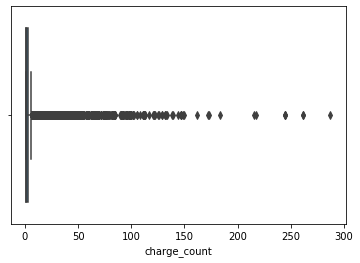

In [41]:
'''
Copied from Data Analysis.ipynb

Identifying numeric (non-boolean) columns 
and visualizing distribution/outliers with boxplot of charge_count
'''

bool_cols = [col for col in total_df if np.isin(total_df[col].dropna().unique(), [0, 1]).all()]
non_bool = total_df.columns.difference(bool_cols)
print('Number of numeric columns: ', len(non_bool), '\n')
print(sns.boxplot(x=total_df['charge_count']))

## MHI Distributions

#### This section is copied from Data Analysis.ipynb

In [42]:
'''
Function to return the fraction of positive instances in inputted subset
'''

def get_portion_true (subset):
    num_true = len(subset[subset['MHI']==1])
    return (num_true/len(subset))

In [43]:
''' 
FEATURE ENGINEERING FOR DATA ANAYLSIS:
create days_since_received feature

chose received because it's the only "start" date without missing values

number of days calculated by subtracting 
from data upload date of December 02, 2019

Useful for censoring analysis
'''

upload_date = pd.to_datetime(pd.datetime.strptime('12/2/2019', '%m/%d/%Y'))
received_date_dt = pd.to_datetime(total_df.received_date)
total_df['days_since_received'] = (upload_date - received_date_dt).astype(str)
total_df['days_since_received'] = total_df['days_since_received'].map(lambda x: x.partition(' ')[0])
total_df['days_since_received'] = total_df['days_since_received'].astype(int)

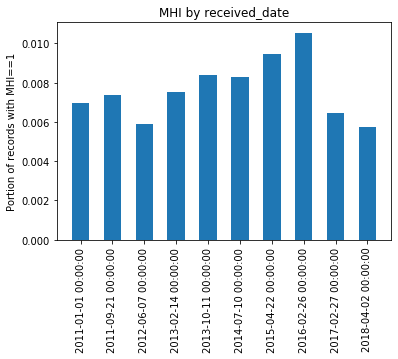

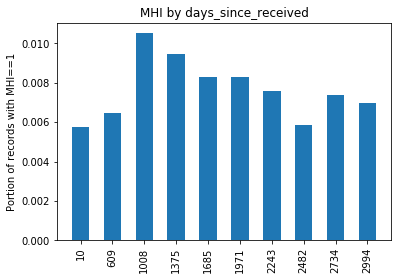

In [44]:
'''
Data Analysis:
Distribution of MHI over Time
'''

def plot_deciles(df, col):

    #get the total number of rows in the df
    n = len(df)

    #sort df by column of interest
    sorted_df = df.sort_values(by=[col])

    #create deciles, ie bins of the column of interest
    decile_1 = sorted_df.iloc[0:round(n/10)]
    decile_2 = sorted_df.iloc[round(n/10):round(2*n/10)]
    decile_3 = sorted_df.iloc[round(2*n/10):round(3*n/10)]
    decile_4 = sorted_df.iloc[round(3*n/10):round(4*n/10)]
    decile_5 = sorted_df.iloc[round(4*n/10):round(5*n/10)]
    decile_6 = sorted_df.iloc[round(5*n/10):round(6*n/10)]
    decile_7 = sorted_df.iloc[round(6*n/10):round(7*n/10)]
    decile_8 = sorted_df.iloc[round(7*n/10):round(8*n/10)]
    decile_9 = sorted_df.iloc[round(8*n/10):round(9*n/10)]
    decile_10 = sorted_df.iloc[round(9*n/10):n]

    #list of deciles
    deciles = [decile_1, decile_2, decile_3, decile_4, decile_5, 
           decile_6, decile_7, decile_8, decile_9, decile_10]

    #create list of portions
    portions = [get_portion_true(x) for x in deciles]

    #create string labels of earliest date in decile
    labels = [str(x.iloc[0][col]) for x in deciles]

    #plot
    fig, ax = plt.subplots()
    ax.bar(labels, portions, width=.55)
    ax.set_xticklabels(labels, rotation = 90)
    ax.set_ylabel('Portion of records with MHI==1')
    plt.title('MHI by {}'.format(col))
    plt.show()
    return

time_features_to_plot = ['received_date', 'days_since_received']

for column in time_features_to_plot:
      plot_deciles(total_df, column)

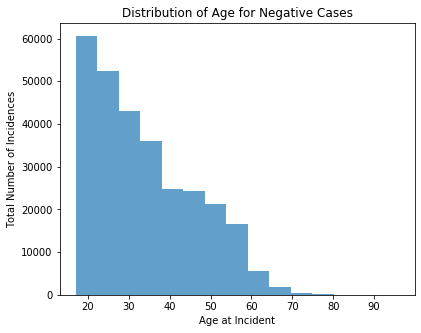

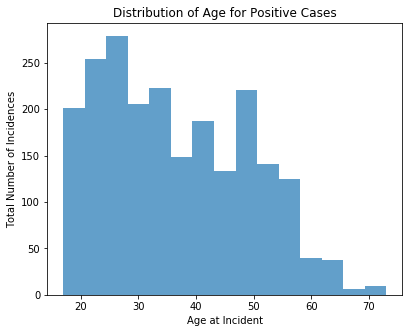

In [45]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Age
'''

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.hist(total_df['age_at_incident'][total_df['MHI'] == 0], bins=15, alpha = 0.7, label = 'MHI False')
plt.ylabel('Total Number of Incidences')
plt.xlabel('Age at Incident')
plt.title('Distribution of Age for Negative Cases')
plt.show()

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.hist(total_df['age_at_incident'][total_df['MHI'] == 1], bins=15, alpha = 0.7, label = 'MHI True')
plt.xlabel('Age at Incident')
plt.ylabel('Total Number of Incidences')
plt.title('Distribution of Age for Positive Cases')
plt.show()

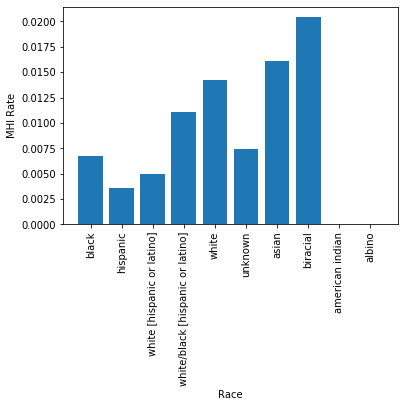

In [46]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Race
'''

races = ['black', 'hispanic', 'white [hispanic or latino]', 
         'white/black [hispanic or latino]', 'white', 'unknown', 'asian', 
         'biracial', 'american indian', 'albino']

dummy_encoded_races = ['race_' + x for x in races]

race_portions=[]
for i in dummy_encoded_races:
    race_portions.append(get_portion_true(total_df[total_df[i] == 1]))

plt.bar(races, race_portions)
plt.ylabel('MHI Rate')
plt.xlabel('Race')
plt.xticks(races, rotation='vertical')
plt.show()

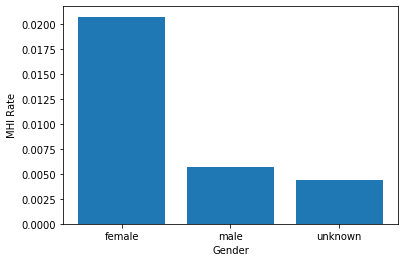

In [47]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Gender
'''

female = get_portion_true(total_df[total_df['gender_female'] == 1])
male = get_portion_true(total_df[total_df['gender_male'] == 1])
unknown = get_portion_true(total_df[total_df['gender_unknown'] == 1])

gender_portions=[female, male, unknown]
         
plt.bar(['female','male', 'unknown'], gender_portions )
plt.ylabel('MHI Rate')
plt.xlabel('Gender')
plt.show()

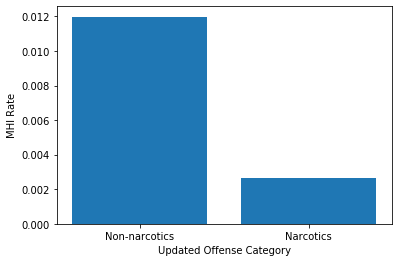

In [48]:
''' 
Data Analysis:
Looking at MHI Base Rates
For narcotics vs. non-narcotics cases

using updated_offense_category_narcotics feature
'''

narcotics0 = get_portion_true(total_df[total_df['updated_offense_category_narcotics'] == 0])
narcotics1 = get_portion_true(total_df[total_df['updated_offense_category_narcotics'] == 1])

portions=[narcotics0, narcotics1]
         
plt.bar(['Non-narcotics','Narcotics'], portions )
plt.ylabel('MHI Rate')
plt.xlabel('Updated Offense Category')
plt.show()

In [49]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Train/Validation/Test

Calls get_train_val_test from Final_Data_Prep notebook
Train/val/test split will be identical to split used for modelling
Because splitting function strictly time-based, no randomness
'''

from Final_Data_Prep import get_train_val_test
X_train, X_val, X_test, y_train, y_val, y_test = get_train_val_test (total_df, 0.7, 0.15, 0.15)
  
training_df = X_train.join(y_train)
val_df = X_val.join(y_val)
train_and_val_df = pd.concat([training_df, val_df], verify_integrity=True)
test_df = X_test.join(y_test)

print ("Training base rate: ", get_portion_true(training_df))
print ("Validation base rate: ", get_portion_true(val_df))
print ("Training+Validation base rate: ", get_portion_true(train_and_val_df))
print ("Test base rate: ", get_portion_true(test_df))

Training base rate:  0.007684097130940968
Validation base rate:  0.009155059496356425
Training+Validation base rate:  0.007943678020591706
Test base rate:  0.0059958951179577055
